In [38]:
import pandas as pd
import numpy as np
import yaml
from sklearn.manifold import TSNE
from sklearn.cluster import DBSCAN
from scipy.fft import fft
from scipy.stats import boxcox
from scipy.special import inv_boxcox
import matplotlib.pyplot as plt
from plotly.subplots import make_subplots
from sklearn.preprocessing import StandardScaler, OneHotEncoder, LabelEncoder, MinMaxScaler, PowerTransformer, RobustScaler
from sklearn.linear_model import LinearRegression
import openpyxl
import plotly.graph_objects as go
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, recall_score,precision_score, f1_score, mean_squared_error
from sklearn.metrics import average_precision_score
import xgboost as xgb
from xgboost.callback import TrainingCallback
import optuna
import talib
import json
import pickle
import torch
import os
import logging
from scipy.stats.mstats import winsorize
from plotly.subplots import make_subplots
import seaborn as sns
from imblearn.over_sampling import SMOTEN
import smogn
import warnings
from datetime import datetime, timedelta
from sklearn.utils import resample


In [39]:
print(torch.backends.mps.is_available())

True


In [40]:
def load_yaml(file):
    import yaml
    with open(file, 'r') as f:
        config = yaml.safe_load(f)
    return config
    



In [41]:
config = load_yaml('../config_xgRegSlope.yaml')

In [42]:
for handler in logging.root.handlers[:]:
    logging.root.removeHandler(handler)

log_dir = "logs"
os.makedirs(log_dir, exist_ok=True)
log_file = "logstraining_logs_xgClass_AUC_1minute.txt"
log_file_path = os.path.join(log_dir, log_file)
print(log_file_path)
logging.basicConfig(
    filename=log_file_path,
    level=logging.INFO,
    format="%(asctime)s - %(levelname)s - %(message)s",
    datefmt="%Y-%m-%d %H:%M:%S"
)

logging.info("Logging started")

logs/logstraining_logs_xgClass_AUC_1minute.txt


In [43]:
all_trading_data_dfs = []
sheet_names = ['1minData1-6-2022', '1minData1-12-2023', '1minData1-22-2024']
for sheet in sheet_names:
    temp_df = pd.read_excel(config['all_data_excel_path'], sheet_name=sheet)
    all_trading_data_dfs.append(temp_df)
all_trading_data = pd.concat(all_trading_data_dfs, ignore_index=True)

# Load 5 min data
all_trading_data['Date'] = pd.to_datetime(all_trading_data['Date'])

In [44]:
##### Set the Date Start and End for the filtering of trading data
train_start_date = pd.to_datetime('2023-01-01')
train_end_date = pd.to_datetime('2023-12-31')
trading_data_raw = all_trading_data[(all_trading_data['Date'] >= train_start_date) & (all_trading_data['Date'] <= train_end_date)]
trading_data_raw = trading_data_raw.reset_index(drop=True)
trading_data_raw.drop(columns=['Symbol'], inplace=True)
trading_data_raw.info() 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 97532 entries, 0 to 97531
Data columns (total 6 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   Date    97532 non-null  datetime64[ns]
 1   Open    97532 non-null  float64       
 2   High    97532 non-null  float64       
 3   Low     97532 non-null  float64       
 4   Close   97532 non-null  float64       
 5   Volume  97532 non-null  int64         
dtypes: datetime64[ns](1), float64(4), int64(1)
memory usage: 4.5 MB


In [45]:
fourier_lookback_window = config['fourier_lookback_window']
fourier_n_components = config['fourier_n_components']
m_bars = config['m_future']

In [46]:
def calculate_bollinger_bands(data, window_size, num_std_dev):
    rolling_mean = data['Close'].rolling(window=window_size).mean()
    rolling_std = data['Close'].rolling(window=window_size).std()
    data['BOLLBU'] = rolling_mean + (rolling_std * num_std_dev)
    data['BOLLBM'] = rolling_mean
    data['BOLLBL'] = rolling_mean - (rolling_std * num_std_dev)
    
    return data

def calculate_donchn_bands(data, window_size):
    data['DONCH_U'] = data['High'].rolling(window=window_size).max()
    data['DONCH_L'] = data['Low'].rolling(window=window_size).min()
    
    return data
    
def calculate_tchr(data):
    period = config['tchr_period']
    retracement = config['tchr_retracement']
    adj = config['tchr_adj']
    range = config['tchr_range']

    if range == 'highlow':
        data['TCHR_U'] = talib.MAX(data['High'], timeperiod=period) + adj
        data['TCHR_L'] = talib.MIN(data['Low'], timeperiod=period) - adj
    elif range == 'close':
        data['TCHR_U'] = talib.MAX(data['Close'], timeperiod=period) + adj
        data['TCHR_L'] = talib.MIN(data['Close'], timeperiod=period) - adj
    
    #calculate retracement
    if retracement == "long":
        data['TCHR'] = (data['Close'] - data['TCHR_L']) / (data['TCHR_U'] - data['TCHR_L'])
    elif retracement == "short":
        data['TCHR'] = (data['TCHR_U'] - data['Close']) / (data['TCHR_U'] - data['TCHR_L'])
    
    return data
    
def calculate_adwm(data):
    period = config['adwm_period']
    data['Previous_Close']= data['Close'].shift(1)
    data['TRH'] = data[['High', 'Previous_Close']].max(axis=1)
    data['TRL'] = data[['Low', 'Previous_Close']].min(axis=1)

    data['ADWM_AD'] = 0.0
    data.loc[data['Close'] > data['Previous_Close'], 'ADWM_AD'] = (data['Close'] - data['TRL'])
    data.loc[data['Close'] < data['Previous_Close'], 'ADWM_AD'] = (data['Close'] - data['TRH'])

    data['ADWM'] = data['ADWM_AD']

    data['ADWMMA'] = data['ADWM'].rolling(window=period).mean()

    return data

def calculate_si(row, prev_row, limit):
    if pd.isna(prev_row['Close']):
        return 0
    c = row['Close']
    c_prev = prev_row['Close']
    o = row['Open']
    o_prev = prev_row['Open']
    return (50 * ((c - c_prev) + (0.5 * (c - o)) + (0.25 * (c_prev - o_prev))) / limit)

def calculate_WASI(data):
    wasi_limit = config['wasi_limit']
    data['SI'] = data.apply(lambda row: calculate_si(row, data.shift(1).loc[row.name], wasi_limit), axis=1)
    data['WASI'] = data['SI']
    return data

def calculate_ATR(data):
    atr_period = config['atr_period']
    atr_ma = config['atr_ma']
    data['ATR'] = talib.ATR(data['High'], data['Low'], data['Close'], timeperiod=atr_period)
    data['ADJATR'] = talib.SMA(data['ATR'], timeperiod=atr_ma)
    return data


def compute_volatility_momentum(df, price_col='Close', vol_window=14, mom_window=10):
    """
    Computes rolling volatility and momentum for a given price column.

    Parameters:
        df (pd.DataFrame): DataFrame containing historical price data.
        price_col (str): Column name of the closing price.
        vol_window (int): Window size for rolling volatility calculation.
        mom_window (int): Window size for momentum calculation.

    Returns:
        pd.DataFrame: DataFrame with added 'Volatility' and 'Momentum' features.
    """

    # Ensure price column exists
    if price_col not in df.columns:
        raise ValueError(f"Column '{price_col}' not found in DataFrame")

    # 🔹 Compute Log Returns (for better volatility calculation)
    df['Log_Returns'] = np.log(df[price_col] / df[price_col].shift(1))

    # 🔹 Compute Rolling Volatility (Standard Deviation of Log Returns)
    df['Volatility'] = df['Log_Returns'].rolling(window=vol_window).std()

    # 🔹 Compute Momentum (Rate of Change in Price)
    df['Momentum'] = df[price_col].pct_change(periods=mom_window) * 100

    # 🔹 Drop NaN values from rolling computations
    #df.dropna(inplace=True)

    return df


def compute_fourier_df(value_series, n_components=10):
    fft_result = np.fft.fft(value_series)
    real = fft_result.real[:n_components]
    imag = fft_result.imag[:n_components]
    mag = np.abs(fft_result)[:n_components]

    return real, imag, mag

def get_fourier_columns():
    return [f'fourier_real_{j+2}' for j in range(fourier_n_components-1)] + [f'fourier_imag_{j+2}' for j in range(fourier_n_components-1)] + [f'fourier_mag_{j+2}' for j in range(fourier_n_components-1)]   

def transform_features(df):
    close_diff_features = config['Close_Diff_Features'].split(',')
    df[close_diff_features] = df[close_diff_features].sub(df['Close'], axis=0).div(df['Close'], axis=0)
    return df

def get_all_training_features():
    training_features = config['training_features'].split(',')
    fourier_cols = get_fourier_columns()
    return training_features + fourier_cols

def normalize_timegaps(df, time_gap_threshold=300):
    df = df.copy()
    features = ['Open', 'High', 'Low', 'Close']
    df['time_delta'] = df['Date'].diff().dt.total_seconds()
    df['time_delta'] = df['time_delta'].fillna(df['time_delta'].median())
    df['time_gap_flag'] = df['time_delta'] > time_gap_threshold
    gap_indices = df.index[df['time_gap_flag']].tolist()
    for p in gap_indices:
        if p > 0: # ensure p-1 exist
            jump_value = df.loc[p, 'Close'] - df.loc[p-1, 'Close']
            df.loc[:p-1, features] += jump_value
    return df

In [47]:
def add_new_features_df(data):
    fourier_lookback_window = config['fourier_lookback_window']
    fourier_n_components = config['fourier_n_components']

    #data['Date'] = pd.to_datetime(data['Date'])
    #print(f"bolband period : {config['bolband_period']}")
    bolband_period = config['bolband_period']
    bolband_width = config['bolband_width']
    upper, middle, lower = talib.BBANDS(data['Close'], timeperiod=bolband_period, nbdevup=bolband_width, nbdevdn=bolband_width, matype=0)
    data['BOLLBU'] = upper
    data['BOLLBM'] = middle
    data['BOLLBL'] = lower
    #data = calculate_bollinger_bands(data, int(config['bolband_period']), int(config['bolband_width']))

    # Calculate DONCHN Bands
    donchn_period = config['donchn_period']
    data['DONUP'] = talib.MAX(data['High'], timeperiod=donchn_period)

    data['DONLOW'] = talib.MIN(data['Low'], timeperiod=donchn_period)

    data['DONMID'] = (data['DONLOW'] + data['DONUP']) / 2

    data['MA20'] = talib.SMA(data['Close'], timeperiod=20)

    data['MA50'] = talib.SMA(data['Close'], timeperiod=50)

    data['MA100'] = talib.SMA(data['Close'], timeperiod=100)

    data['EMA20'] = talib.EMA(data['Close'], timeperiod=20)

    # Calculate the pivot points
    data['PVPT'] = (data['High'] + data['Low'] + data['Close']) / 3
    data['PVPTR1'] = (2 * data['PVPT']) - data['Low']

    data['PVPTR2'] = data['PVPT'] + data['High'] - data['Low']

    data['PVPTR3'] = data['High'] + 2 * (data['PVPT'] - data['Low'])

    data['PVPTS1'] = (2 * data['PVPT']) - data['High']

    data['PVPTS2'] = data['PVPT'] - (data['High'] - data['Low'])

    data['PVPTS3'] = data['Low'] - 2 * (data['High'] - data['PVPT'])

    data = calculate_tchr(data)

    data = calculate_adwm(data)

    data = calculate_WASI(data)

    volume_ma_period = config['volume_ma_period']

    data['VOLMA'] = talib.SMA(data['Volume'], timeperiod=volume_ma_period)

    data = calculate_ATR(data)

    data['DayofWeek'] = data['Date'].dt.dayofweek

    data['DayofWeek'] = data['DayofWeek'].astype('category')

    data = compute_volatility_momentum(data, price_col='Close', vol_window=config['volatility_period'], mom_window=config['momentum_period'])

    # Add fourier columns to the df
    for i in range(fourier_n_components):
        data[f'fourier_real_{i+1}'] = np.nan
        data[f'fourier_imag_{i+1}'] = np.nan
        data[f'fourier_mag_{i+1}'] = np.nan

    features = []
    epsilon = 1e-5
    #print(f"fourier window - 1 : {fourier_lookback_window - 1}")
    for i in range(len(data)):
        if i >= fourier_lookback_window - 1:
            #print("entered point 1")
            close_window = data['Close'].iloc[i - fourier_lookback_window + 1: i + 1].values
            real, imag, mag = compute_fourier_df(close_window, n_components=fourier_n_components)

            for j in range(fourier_n_components):
                data.iloc[i, data.columns.get_loc(f'fourier_real_{j+1}')] = real[j]
                data.iloc[i, data.columns.get_loc(f'fourier_imag_{j+1}')] = imag[j]
                data.iloc[i, data.columns.get_loc(f'fourier_mag_{j+1}')] = mag[j]
                #print(data.loc[i, 'Date'])
    


    # Add the time of day feature to the trading data

    # Define max time of day in minutes
    MAX_TIME_MINUTES = 1440
    data['Minutes_Passed'] = (data['Date'].dt.hour* 60) + data['Date'].dt.minute
    data['TimeOfDay_Group'] = (data['Minutes_Passed'] // 5).astype('int')
    data['Sine_TimeOfDay'] = np.sin(2 * np.pi * data['TimeOfDay_Group'] / MAX_TIME_MINUTES)
    data['Cosine_TimeOfDay'] = np.cos(2 * np.pi * data['TimeOfDay_Group'] / MAX_TIME_MINUTES)
    data['Take_Profit_Level'] = (data['Close'] * config['atr_multiplier'] * data['ADJATR'])
    data['time_delta'] = data['Date'].diff().dt.total_seconds()
    data['time_delta'].fillna(data['time_delta'].median(), inplace=True)
    #print("Feature df info : ")
    #print(data.info())

    #print(f"Last row after adding features : ")
    #print(data.tail())
    return data


In [48]:
trading_data_time_normalized = normalize_timegaps(trading_data_raw)

In [49]:
toplot_df = trading_data_time_normalized

fig = make_subplots(rows=2, cols=1, shared_xaxes=True, 
                    vertical_spacing=0.1,
                    subplot_titles=("CandleStick Chart Norm", "CandleStick Chart"))
fig.add_trace(
    go.Candlestick(
        x=toplot_df['Date'], 
        open=toplot_df['Open'], 
        high=toplot_df['High'], 
        low=toplot_df['Low'], 
        close=toplot_df['Close'],
        name='OHLC Norm'
        ), row=1, col=1
)

fig.add_trace(
    go.Candlestick(
        x=trading_data_raw['Date'], 
        open=trading_data_raw['Open'], 
        high=trading_data_raw['High'], 
        low=trading_data_raw['Low'], 
        close=trading_data_raw['Close'],
        name='OHLC'
        ), row=2,col=1
)

fig.update_layout(
    title='CandleStick chart of time normalized',
    xaxis=dict(type="date", 
               rangebreaks=[
                   dict(bounds=["sat", "mon"]),
                   dict(bounds=[16,9.5], pattern='hour')
               ]              
            ),
    xaxis_rangeslider_visible=False,
    height=600,
    hovermode='x unified'
)



fig.update_xaxes(matches='x')

fig.show()

In [50]:

def calculate_label(data):

# Define the threshold for buy and sell signals
    
    buy_powers = []
    sell_powers = []
    n=config['bars_no_to_wait']
    for i in range(len(data)):
        current_close = data.loc[i, "Close"]

        future_closes = data.loc[i+1: i+n+1, "Close"].values

        if len(future_closes) == 0:
            buy_powers.append(0)
            sell_powers.append(0)
            continue
        future_close_max = max(future_closes) 
        future_close_min = min(future_closes)
        max_high = future_close_max - current_close
        min_high = current_close - future_close_min
        max_high_idx = list(future_closes).index( future_close_max)
        min_high_idx = list(future_closes).index( future_close_min)

        if max_high_idx == (len(future_closes) - 1): #when max value is at the last of window
            buy_retr_penalty = 0
        else:
            buy_retr_penalty = future_close_max - min(future_closes[max_high_idx+1:])
        max_down_below = max(0, current_close - future_close_min)
        penalty_buy = buy_retr_penalty + max_down_below
        buy_power = max(0, max_high - penalty_buy)

        if min_high_idx == (len(future_closes) - 1): 
            sell_retr_penalty = 0
        else:
            sell_retr_penalty = max(future_closes[min_high_idx+1:]) - future_close_min
        max_up_above = max(0, future_close_max - current_close)
        penalty_sell = sell_retr_penalty + max_up_above
        sell_power = max(0, min_high - penalty_sell)

        buy_powers.append(buy_power)
        sell_powers.append(sell_power)

    data['BuyPower'] = buy_powers
    data['SellPower'] = sell_powers
        

    return data

In [51]:
trading_data_with_power = calculate_label(trading_data_time_normalized)
trading_data_with_power.dropna(inplace=True)

In [52]:
trading_data_with_power[['BuyPower']].describe()

,BuyPower
count,97532.000000
mean,0.141181
std,0.294040
min,0.000000
25%,0.000000
50%,0.000000
75%,0.165000
max,6.820000


In [53]:
trading_data_with_power[['SellPower']].describe()

,SellPower
count,97532.000000
mean,0.134642
std,0.308332
min,0.000000
25%,0.000000
50%,0.000000
75%,0.110000
max,4.890000


In [54]:
trading_data_with_power[(trading_data_with_power['BuyPower'] == 0) | (trading_data_with_power['SellPower'] == 0)].count()
#trading_data_with_slope.count()

Date             97532
Open             97532
High             97532
Low              97532
Close            97532
Volume           97532
time_delta       97532
time_gap_flag    97532
BuyPower         97532
SellPower        97532
dtype: int64

In [55]:
trading_data_with_features = add_new_features_df(trading_data_with_power.copy())

KeyboardInterrupt: 

In [ ]:
##### Save to parquet file to load quickly next time
trading_data_with_features.to_parquet('../Parquet/trading_data_with_features_auc1min.parquet', index=False, engine='pyarrow')

In [56]:
trading_data_with_features_loaded = pd.read_parquet('../Parquet/trading_data_with_features_auc1min.parquet', engine='pyarrow')

In [57]:
trading_data_with_features_loaded.describe().T

,count,mean,min,25%,50%,75%,max,std
Date,97532,2023-07-01 23:12:09.609769216,2023-01-03 09:30:00,2023-03-31 12:52:45,2023-07-03 09:45:30,2023-10-02 09:37:15,2023-12-29 15:59:00,NaN
Open,97532.0,456.519912,404.1511,446.8041,455.8416,469.0678,490.0516,17.612616
High,97532.0,456.620072,404.4911,446.939,455.922,469.1528,490.1816,17.593923
Low,97532.0,456.417651,403.8011,446.689,455.7559,468.977825,489.9812,17.629301
Close,97532.0,456.520556,404.1611,446.8059,455.8459,469.0653,490.0566,17.612358
Volume,97532.0,149756.073627,1039.0,70910.0,107538.5,171029.25,8399016.0,219216.784967
time_delta,97532.0,319.150638,-23340.0,60.0,60.0,60.0,322260.0,6402.690241
BuyPower,97532.0,0.141181,0.0,0.0,0.0,0.165,6.82,0.29404
SellPower,97532.0,0.134642,0.0,0.0,0.0,0.11,4.89,0.308332
BOLLBU,97513.0,456.96415,405.863198,447.320135,456.341019,469.443834,490.246311,17.530304


In [58]:

def calculate_label_class(data, future_bars=20):

    n=future_bars
    signal = []
    for i in range(len(data)):
        current_close = data.loc[i, "Close"]
        current_high = data.loc[i, "High"]
        current_low = data.loc[i, "Low"]

        future_highs = data.loc[i+1: i+n+1, "High"].values
        future_lows = data.loc[i+1: i+n+1, "Low"].values
        
        if len(future_highs) == 0:
            signal.append(1)
            continue
        future_high_max = max(future_highs) 
        future_low_min = min(future_lows)
        if future_high_max > current_close and future_low_min > current_low:
            signal.append(2)
        elif future_high_max < current_high and future_low_min < current_close:
            signal.append(0)
        else:
            signal.append(1)

    data['Signal'] = signal
        
    return data

In [59]:
trading_data_with_features = calculate_label_class(trading_data_with_features, future_bars=24)

In [ ]:
pd.set_option("display.max_columns", None)  # Show all columns
pd.set_option("display.max_rows", None)  # Show all rows
trading_data_with_features.describe().T

,count,mean,min,25%,50%,75%,max,std
Date,97532,2023-07-01 23:12:09.609769216,2023-01-03 09:30:00,2023-03-31 12:52:45,2023-07-03 09:45:30,2023-10-02 09:37:15,2023-12-29 15:59:00,NaN
Open,97532.0,456.519912,404.1511,446.8041,455.8416,469.0678,490.0516,17.612616
High,97532.0,456.620072,404.4911,446.939,455.922,469.1528,490.1816,17.593923
Low,97532.0,456.417651,403.8011,446.689,455.7559,468.977825,489.9812,17.629301
Close,97532.0,456.520556,404.1611,446.8059,455.8459,469.0653,490.0566,17.612358
Volume,97532.0,149756.073627,1039.0,70910.0,107538.5,171029.25,8399016.0,219216.784967
time_delta,97532.0,319.150638,-23340.0,60.0,60.0,60.0,322260.0,6402.690241
BuyPower,97532.0,0.141181,0.0,0.0,0.0,0.165,6.82,0.29404
SellPower,97532.0,0.134642,0.0,0.0,0.0,0.11,4.89,0.308332
BOLLBU,97513.0,456.96415,405.863198,447.320135,456.341019,469.443834,490.246311,17.530304


In [60]:
trading_data_with_features['Signal'].value_counts()

Signal
1    73862
2    12803
0    10867
Name: count, dtype: int64

#### Going to define a feature that is categorical with 3 classes
##### It separates the records into no action, buy action and sell action
##### There is a separation boundary of values that we are going to ignore and just focus on the extreme values

In [61]:
trading_data_with_features.shape[0]

97532

In [62]:
#trading_data['Date'] = pd.to_datetime(trading_data['Date'])
fig = go.Figure(data=[go.Candlestick(x=trading_data_with_features['Date'], open=trading_data_with_features['Open'], high=trading_data_with_features['High'], low=trading_data_with_features['Low'], close=trading_data_with_features['Close'])])
fig.update_layout(title='CandleStick Chart SPY', xaxis_title='Date', yaxis_title='Price', xaxis_rangeslider_visible=False, yaxis=dict(fixedrange=False), xaxis=dict(type='category'))
buy_signals = trading_data_with_features[trading_data_with_features['Signal'] == 2]
sell_signals = trading_data_with_features[trading_data_with_features['Signal'] == 0]
fig.add_trace(go.Scatter(x=buy_signals['Date'], y=buy_signals['Low'], mode='markers', name='Buy Signal', marker=dict(color='blue', size=10), text="Buy Signal"))
fig.add_trace(go.Scatter(x=sell_signals['Date'], y=sell_signals['High'], mode='markers', name='Sell Signal', marker=dict(color='yellow', size=10), text="Sell Signal"))
fig.show()

####  Transform Features that have to be differenced from Close

In [63]:
trading_data_transformed = transform_features(trading_data_with_features.copy())

In [64]:
all_training_features = get_all_training_features()

#### Do Robust scaling on all training features

In [65]:
trading_data_scaled = trading_data_transformed.copy()
rscaler = RobustScaler()
trading_data_scaled[all_training_features] = rscaler.fit_transform(trading_data_scaled[all_training_features])

#### Use Clipping (Winsorization) to Limit Extreme Values

In [66]:
def winsor_features(df, features, lower=5, upper=95, inference=False, limits = None):
    df = df.copy()
    if not inference:
        limits = {}
        lower_limit = lower / 100
        upper_limit = (100 - upper) / 100
        for feature in features:
            df[feature] = winsorize(df[feature], limits=(lower_limit, upper_limit))
            lower_value = np.percentile(df[feature], lower)
            upper_value = np.percentile(df[feature], upper)
            limits[feature] = (lower_value, upper_value)
        return df, limits
    else:
        for feature in features:
            lower_value, upper_value = limits[feature]
            df[feature] = np.clip(df[feature], lower_value, upper_value)
        return df

In [67]:
### Set lower limit and upper limit for winsor
lower_limit_winsor = 5
upper_limit_Winsor = 95
### Apply the winsorization for all training features
trading_data_scaled, winsor_limits = winsor_features(df=trading_data_scaled, 
                                      features=all_training_features, 
                                      lower=lower_limit_winsor, 
                                      upper=upper_limit_Winsor,
                                      inference=False
                                      )



In [68]:
winsor_limits

{'Open': (np.float64(-1.4706401801270723), np.float64(1.5209709539308234)),
 'High': (np.float64(-0.6237761135914047), np.float64(2.152232457662581)),
 'Low': (np.float64(-2.117130992960375), np.float64(0.6915067828745822)),
 'BOLLBU': (np.float64(-0.676338980557974), np.float64(2.3462721050542235)),
 'BOLLBL': (np.float64(-2.149178827807187), np.float64(0.7755880736579542)),
 'DONUP': (np.float64(-0.599367792569103), np.float64(2.1288498916970013)),
 'DONLOW': (np.float64(-2.005523684949732), np.float64(0.7236481075041669)),
 'MA20': (np.float64(-1.3967383956974868), np.float64(1.5808208931956655)),
 'MA50': (np.float64(-1.3540161188983892), np.float64(1.5932742049205024)),
 'MA100': (np.float64(-1.3104356787950222), np.float64(1.5663232163220764)),
 'EMA20': (np.float64(-1.3693775315954901), np.float64(1.6001496194579838)),
 'PVPTR1': (np.float64(-0.7247193803991732), np.float64(2.225867445177961)),
 'PVPTR2': (np.float64(-0.7247193803997294), np.float64(2.2258674451773217)),
 'PVPTR

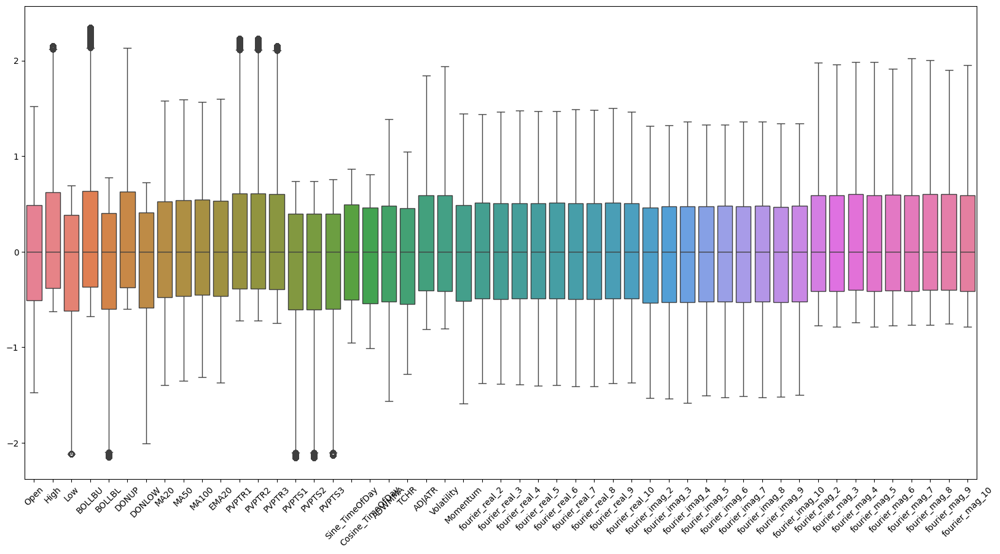

In [69]:
plt.figure(figsize=(20, 10))
sns.boxplot(data=trading_data_scaled[all_training_features])
plt.xticks(rotation=45)
plt.show()

In [70]:
trading_data_scaled.shape[0]

97532

#### Undersample class 1

In [ ]:
def resample_data(df, sample_count):
    df_class_0 = df[df['TradeAction'] == 0]
    df_class_1 = df[df['TradeAction'] == 1]
    df_class_2 = df[df['TradeAction'] == 2]

    #Downsample class 1 to 10000
    df_class_1_downsampled = resample(df_class_1, replace=False, n_samples=sample_count, random_state=42)

    df_balanced = pd.concat([df_class_0, df_class_1_downsampled, df_class_2])

    #Shuffle
    df_balanced = df_balanced.sample(frac=1, random_state=42).reset_index(drop=True)
    return df_balanced

#### Split the dataset into buy dataset and sell dataset

In [71]:
#### Split the dataset into buy dataset and sell dataset
buy_dataset = trading_data_scaled[(trading_data_scaled['Signal'] == 2) | (trading_data_scaled['Signal'] == 1)]
sell_dataset = trading_data_scaled[(trading_data_scaled['Signal'] == 0) | (trading_data_scaled['Signal'] == 1)]

In [72]:
#### Set signal value to 1 for buy and sell
sell_dataset['Signal'] = sell_dataset['Signal'].map({0: 1, 1: 0})
buy_dataset['Signal'] = buy_dataset['Signal'].map({2: 1, 1: 0})

/var/folders/ns/6tgyd_dx5lq_3chvzvfdm1sr0000gp/T/ipykernel_853/1844941159.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/ns/6tgyd_dx5lq_3chvzvfdm1sr0000gp/T/ipykernel_853/1844941159.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [73]:
sell_dataset['Signal'] = sell_dataset['Signal'].astype('int')
buy_dataset['Signal'] = buy_dataset['Signal'].astype('int')
sell_dataset['Signal'].value_counts()

/var/folders/ns/6tgyd_dx5lq_3chvzvfdm1sr0000gp/T/ipykernel_853/2690437447.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/ns/6tgyd_dx5lq_3chvzvfdm1sr0000gp/T/ipykernel_853/2690437447.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Signal
0    73862
1    10867
Name: count, dtype: int64

In [74]:
print(f"Buy dataset shape : {buy_dataset.shape} \n Sell dataset shape : {sell_dataset.shape}")

Buy dataset shape : (86665, 81) 
 Sell dataset shape : (84729, 81)


In [75]:
X_buy = buy_dataset[all_training_features]
y_buy = buy_dataset['Signal']
X_sell = sell_dataset[all_training_features]
y_sell = sell_dataset['Signal']

In [76]:

X_train_buy, X_test_buy, y_train_buy, y_test_buy = train_test_split(X_buy, y_buy, test_size=0.2, stratify=buy_dataset['Signal'], random_state=43)
X_train_sell, X_test_sell, y_train_sell, y_test_sell = train_test_split(X_sell, y_sell, test_size=0.2, stratify=sell_dataset['Signal'], random_state=43)


#### Lets Train the Buy model first

In [77]:
print(X_buy.info())

<class 'pandas.core.frame.DataFrame'>
Index: 86665 entries, 0 to 97531
Data columns (total 51 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Open              86665 non-null  float64
 1   High              86665 non-null  float64
 2   Low               86665 non-null  float64
 3   BOLLBU            86665 non-null  float64
 4   BOLLBL            86665 non-null  float64
 5   DONUP             86665 non-null  float64
 6   DONLOW            86665 non-null  float64
 7   MA20              86665 non-null  float64
 8   MA50              86665 non-null  float64
 9   MA100             86665 non-null  float64
 10  EMA20             86665 non-null  float64
 11  PVPTR1            86665 non-null  float64
 12  PVPTR2            86665 non-null  float64
 13  PVPTR3            86665 non-null  float64
 14  PVPTS1            86665 non-null  float64
 15  PVPTS2            86665 non-null  float64
 16  PVPTS3            86665 non-null  float64
 17

In [78]:
#convert data to d matrix to use with xgb
enab_cat = False
dtrain_buy = xgb.DMatrix(X_train_buy, label=y_train_buy )
dtest_buy = xgb.DMatrix(X_test_buy, label=y_test_buy)
dtrain_sell = xgb.DMatrix(X_train_sell, label=y_train_sell )
dtest_sell = xgb.DMatrix(X_test_sell, label=y_test_sell)

In [79]:
X_test_buy.shape

(17333, 51)

In [80]:
num_boosting_rounds = 30000
##### Implement initial training of the model   
learning_rate = 0.01
starting_tree_method = 'approx'
#metric can be mlogloss, auc, merror etc
metric = 'aucpr'

base_params = {
    'objective': 'binary:logistic',
    'eval_metric': metric,
}

params = {
    'tree_method': starting_tree_method
}

params.update(base_params)

##### Define a cosine decay function for Learning Rate to get modified dynamically

In [81]:
class CosineDecayCallback(TrainingCallback):
    def __init__(self, num_rounds, initial_lr, final_lr):
        self.num_rounds = num_rounds
        self.initial_lr = initial_lr
        self.final_lr = final_lr

    def after_iteration(self, model, epoch, evals_log):
        new_lr = self.final_lr + 0.5 * (self.initial_lr - self.final_lr) * (1 + np.cos(np.pi * epoch / self.num_rounds))
        model.set_param('learning_rate', new_lr)
        return False

In [82]:
def custom_score(y_true, y_pred):
    return np.sum((y_true == 1) & (y_pred == 1)), np.sum((y_true == 0) & (y_pred == 1))

In [83]:
##### CReate the objective function for optuna to tune tree parameters
def objective(trial, BuyOrSell = 'Buy'):
    #print("Point 0")

    # Tune the initial and final learning rate
    initial_lr = trial.suggest_float('initial_lr', 0.01, 0.1, log=True)
    final_lr = trial.suggest_float('final_lr', 0.0001, 0.005, log=True)
    params = {
        'tree_method' : trial.suggest_categorical('tree_method', ['approx', 'hist']) , 
        'gamma': trial.suggest_float('gamma', 1e-2, 10),
        'max_depth': trial.suggest_int('max_depth', 3, 12),
        'min_child_weight': trial.suggest_float('min_child_weight', 0.001, 10),
        'subsample': trial.suggest_float('subsample', 0.1, 1.0),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 1.0),
        'lambda': trial.suggest_float('lambda', 0.001, 25), 
        'alpha': trial.suggest_float('alpha', 0.001, 10),
        'learning_rate': initial_lr
    }
    #'scale_pos_weight': trial.suggest_float('scale_pos_weight', min(buying_weight, selling_weight), max(buying_weight, selling_weight))
    params.update(base_params)
    #thresholds = [trial.suggest_float(f'threshold_{i}', 0.1, 0.9) for i in ]
    pruning_callback = optuna.integration.XGBoostPruningCallback(trial, f'test-{metric}')
    evals_result = {}
    #print("Point 1")
    #print(dtrain)
    cosine_decay_callback = CosineDecayCallback(num_boosting_rounds, initial_lr, final_lr)
    if BuyOrSell == 'Buy':
        dtrain = dtrain_buy
        dtest = dtest_buy
        y_test = y_test_buy
        
    else:
        dtrain = dtrain_sell
        dtest = dtest_sell
        y_test = y_test_sell
    xgb_model = xgb.train(params=params, dtrain=dtrain, num_boost_round=num_boosting_rounds, 
                          evals=[(dtest, 'test')],
                          early_stopping_rounds=300,
                          verbose_eval=False,
                          callbacks=[cosine_decay_callback, pruning_callback],
                          evals_result=evals_result
                        )
    #print("Point 2")
    probs = xgb_model.predict(dtest)

    threshold = trial.suggest_float('threshold', 0.01, 0.5)

    preds = (probs > threshold).astype(int)
    

    correct, incorrect = custom_score(y_test, preds)
    score = correct - incorrect
    #r_score = recall_score(y_test, probs)
    #p_score = precision_score(y_test, probs)
    #print("Point 3")
    print(f"{BuyOrSell} Trial {trial.number}: Best iteration = {xgb_model.best_iteration}, Balance score = {score}, Correct = {correct}, Incorrect = {incorrect}")

    return score

In [84]:

study_buy = optuna.create_study(direction='maximize') # for metric auc its maximuze, and for mlogloss its minimie
study_buy.optimize(lambda trial: objective(trial, BuyOrSell='Buy'), n_trials=300)

# Get the best parameters
print(f" Best Buy parameters: {study_buy.best_params}")
print(f" Best Buy Accuracy: {study_buy.best_value}")

[I 2025-03-09 20:23:27,029] A new study created in memory with name: no-name-1b0f2fb9-1e8e-44e8-b75a-9723ef066314
[I 2025-03-09 20:23:51,054] Trial 0 finished with value: 12.0 and parameters: {'initial_lr': 0.08133750393078798, 'final_lr': 0.0009998832086801413, 'tree_method': 'approx', 'gamma': 8.70889339858872, 'max_depth': 5, 'min_child_weight': 1.3853079578799798, 'subsample': 0.42206517171973407, 'colsample_bytree': 0.9303369753273462, 'lambda': 0.29751115717759463, 'alpha': 6.87834152770251, 'threshold': 0.4798061781244049}. Best is trial 0 with value: 12.0.


Buy Trial 0: Best iteration = 966, Balance score = 12, Correct = 49, Incorrect = 37


[I 2025-03-09 20:24:07,994] Trial 1 finished with value: -1421.0 and parameters: {'initial_lr': 0.022356030869126922, 'final_lr': 0.0009845257388400766, 'tree_method': 'hist', 'gamma': 7.271604937385506, 'max_depth': 11, 'min_child_weight': 4.965128904056387, 'subsample': 0.6628847878733237, 'colsample_bytree': 0.845169586866227, 'lambda': 2.282426057635691, 'alpha': 6.574180217578745, 'threshold': 0.22258740528914986}. Best is trial 0 with value: 12.0.


Buy Trial 1: Best iteration = 5042, Balance score = -1421, Correct = 1203, Incorrect = 2624


[I 2025-03-09 20:25:10,070] Trial 2 finished with value: -1291.0 and parameters: {'initial_lr': 0.09257391546342374, 'final_lr': 0.0018443487250145202, 'tree_method': 'approx', 'gamma': 4.6474618609481935, 'max_depth': 11, 'min_child_weight': 1.6189224814751644, 'subsample': 0.387916232226341, 'colsample_bytree': 0.6325657750904042, 'lambda': 8.018373095489222, 'alpha': 5.11513280004206, 'threshold': 0.21556649476543546}. Best is trial 0 with value: 12.0.


Buy Trial 2: Best iteration = 2942, Balance score = -1291, Correct = 1315, Incorrect = 2606


[I 2025-03-09 20:25:27,605] Trial 3 finished with value: -17.0 and parameters: {'initial_lr': 0.025378040226826642, 'final_lr': 0.0018416701271686102, 'tree_method': 'approx', 'gamma': 9.507862673020252, 'max_depth': 12, 'min_child_weight': 7.720751088957862, 'subsample': 0.2571001047293904, 'colsample_bytree': 0.7585018120861206, 'lambda': 3.242894944567259, 'alpha': 7.13014718438824, 'threshold': 0.3898882099845112}. Best is trial 0 with value: 12.0.


Buy Trial 3: Best iteration = 655, Balance score = -17, Correct = 152, Incorrect = 169


[I 2025-03-09 20:29:25,603] Trial 4 finished with value: -591.0 and parameters: {'initial_lr': 0.0323426570098285, 'final_lr': 0.00015344188352686347, 'tree_method': 'approx', 'gamma': 0.24011495615560738, 'max_depth': 10, 'min_child_weight': 4.409731882230024, 'subsample': 0.35973218252512756, 'colsample_bytree': 0.6192975680981566, 'lambda': 2.761202973165099, 'alpha': 6.764550662677176, 'threshold': 0.15459605261814938}. Best is trial 0 with value: 12.0.


Buy Trial 4: Best iteration = 8708, Balance score = -591, Correct = 1545, Incorrect = 2136


[I 2025-03-09 20:29:53,930] Trial 5 pruned. Trial was pruned at iteration 5343.
[I 2025-03-09 20:29:54,644] Trial 6 pruned. Trial was pruned at iteration 28.
[I 2025-03-09 20:29:54,766] Trial 7 pruned. Trial was pruned at iteration 3.
[I 2025-03-09 20:29:54,838] Trial 8 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:29:54,870] Trial 9 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:29:54,941] Trial 10 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:29:54,976] Trial 11 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:29:55,082] Trial 12 pruned. Trial was pruned at iteration 3.
[I 2025-03-09 20:29:55,215] Trial 13 pruned. Trial was pruned at iteration 4.
[I 2025-03-09 20:29:55,351] Trial 14 pruned. Trial was pruned at iteration 4.
[I 2025-03-09 20:29:55,390] Trial 15 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:29:55,618] Trial 16 pruned. Trial was pruned at iteration 9.
[I 2025-03-09 20:29:55,796] Trial 17 pruned. Trial was pruned at 

Buy Trial 33: Best iteration = 2574, Balance score = 102, Correct = 333, Incorrect = 231


[I 2025-03-09 20:31:03,819] Trial 35 pruned. Trial was pruned at iteration 295.
[I 2025-03-09 20:31:03,916] Trial 36 pruned. Trial was pruned at iteration 1.
[I 2025-03-09 20:31:03,964] Trial 37 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:31:04,010] Trial 38 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:31:24,300] Trial 39 finished with value: 281.0 and parameters: {'initial_lr': 0.04838813750636866, 'final_lr': 0.0009170623702352564, 'tree_method': 'hist', 'gamma': 0.8481629137719937, 'max_depth': 10, 'min_child_weight': 7.400663804186191, 'subsample': 0.6233072828182036, 'colsample_bytree': 0.8911528320065428, 'lambda': 2.8870393132364667, 'alpha': 4.290675801248953, 'threshold': 0.4963365029734414}. Best is trial 39 with value: 281.0.
[I 2025-03-09 20:31:24,329] Trial 40 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:31:24,367] Trial 41 pruned. Trial was pruned at iteration 0.


Buy Trial 39: Best iteration = 2294, Balance score = 281, Correct = 448, Incorrect = 167


[I 2025-03-09 20:31:38,994] Trial 42 finished with value: 255.0 and parameters: {'initial_lr': 0.08159355120571202, 'final_lr': 0.0014917591085405713, 'tree_method': 'hist', 'gamma': 0.8690111141740979, 'max_depth': 11, 'min_child_weight': 7.524439371750276, 'subsample': 0.7283508243798982, 'colsample_bytree': 0.9457189090871508, 'lambda': 2.9574794551331847, 'alpha': 4.012151047109084, 'threshold': 0.4912341391824101}. Best is trial 39 with value: 281.0.
[I 2025-03-09 20:31:39,095] Trial 43 pruned. Trial was pruned at iteration 3.


Buy Trial 42: Best iteration = 2232, Balance score = 255, Correct = 459, Incorrect = 204


[I 2025-03-09 20:31:48,406] Trial 44 finished with value: 209.0 and parameters: {'initial_lr': 0.0896177136989423, 'final_lr': 0.0009483614091288181, 'tree_method': 'hist', 'gamma': 1.4389901723708638, 'max_depth': 12, 'min_child_weight': 9.344455806580289, 'subsample': 0.7207961400111325, 'colsample_bytree': 0.9965221726287896, 'lambda': 3.2047685093859357, 'alpha': 3.1724528119634607, 'threshold': 0.4908667676020618}. Best is trial 39 with value: 281.0.
[I 2025-03-09 20:31:48,448] Trial 45 pruned. Trial was pruned at iteration 0.


Buy Trial 44: Best iteration = 1440, Balance score = 209, Correct = 403, Incorrect = 194


[I 2025-03-09 20:31:59,982] Trial 46 finished with value: 192.0 and parameters: {'initial_lr': 0.06393156245952031, 'final_lr': 0.0004843325413272718, 'tree_method': 'hist', 'gamma': 1.6516259141909138, 'max_depth': 11, 'min_child_weight': 9.138027993704105, 'subsample': 0.8511057019047235, 'colsample_bytree': 0.9970357490647815, 'lambda': 14.572470960809778, 'alpha': 1.934964656900806, 'threshold': 0.4979643205368336}. Best is trial 39 with value: 281.0.


Buy Trial 46: Best iteration = 2293, Balance score = 192, Correct = 303, Incorrect = 111


[I 2025-03-09 20:32:12,459] Trial 47 finished with value: 196.0 and parameters: {'initial_lr': 0.06227419548425312, 'final_lr': 0.0011580011681557268, 'tree_method': 'hist', 'gamma': 1.5849300772241053, 'max_depth': 11, 'min_child_weight': 9.140194322755221, 'subsample': 0.8363176220665579, 'colsample_bytree': 0.9937878365632162, 'lambda': 14.780106554066471, 'alpha': 1.826285931489244, 'threshold': 0.48991664971657195}. Best is trial 39 with value: 281.0.


Buy Trial 47: Best iteration = 2479, Balance score = 196, Correct = 329, Incorrect = 133


[I 2025-03-09 20:32:27,790] Trial 48 finished with value: 231.0 and parameters: {'initial_lr': 0.06543059231248552, 'final_lr': 0.0004779857441843782, 'tree_method': 'hist', 'gamma': 1.4808439523376675, 'max_depth': 11, 'min_child_weight': 9.105935435168002, 'subsample': 0.8497423039942653, 'colsample_bytree': 0.9872121624980728, 'lambda': 14.340108087904493, 'alpha': 1.1493375101998407, 'threshold': 0.4996576644235838}. Best is trial 39 with value: 281.0.
[I 2025-03-09 20:32:27,910] Trial 49 pruned. Trial was pruned at iteration 5.


Buy Trial 48: Best iteration = 3326, Balance score = 231, Correct = 360, Incorrect = 129


[I 2025-03-09 20:32:28,013] Trial 50 pruned. Trial was pruned at iteration 5.
[I 2025-03-09 20:32:40,032] Trial 51 finished with value: 207.0 and parameters: {'initial_lr': 0.06210238780758184, 'final_lr': 0.0005105349118249402, 'tree_method': 'hist', 'gamma': 1.5412300913559016, 'max_depth': 11, 'min_child_weight': 9.31284865831801, 'subsample': 0.8290774619551228, 'colsample_bytree': 0.9951967691720799, 'lambda': 15.134499894323003, 'alpha': 1.5403468792497528, 'threshold': 0.49794272333366396}. Best is trial 39 with value: 281.0.


Buy Trial 51: Best iteration = 2159, Balance score = 207, Correct = 342, Incorrect = 135


[I 2025-03-09 20:32:55,669] Trial 52 finished with value: 262.0 and parameters: {'initial_lr': 0.061228543914156, 'final_lr': 0.0007818907756759815, 'tree_method': 'hist', 'gamma': 1.122117214424242, 'max_depth': 11, 'min_child_weight': 9.627364765036315, 'subsample': 0.7855786048291974, 'colsample_bytree': 0.9814282717022601, 'lambda': 16.476952087832807, 'alpha': 1.3306710178921721, 'threshold': 0.48747567630216465}. Best is trial 39 with value: 281.0.


Buy Trial 52: Best iteration = 2624, Balance score = 262, Correct = 426, Incorrect = 164


[I 2025-03-09 20:32:55,903] Trial 53 pruned. Trial was pruned at iteration 15.
[I 2025-03-09 20:32:55,942] Trial 54 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:32:56,038] Trial 55 pruned. Trial was pruned at iteration 3.
[I 2025-03-09 20:32:58,289] Trial 56 pruned. Trial was pruned at iteration 197.
[I 2025-03-09 20:32:58,326] Trial 57 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:32:58,367] Trial 58 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:32:59,111] Trial 59 pruned. Trial was pruned at iteration 50.
[I 2025-03-09 20:32:59,188] Trial 60 pruned. Trial was pruned at iteration 3.
[I 2025-03-09 20:33:10,239] Trial 61 finished with value: 216.0 and parameters: {'initial_lr': 0.06572411476641046, 'final_lr': 0.0010951609992424676, 'tree_method': 'hist', 'gamma': 1.4634703975739722, 'max_depth': 11, 'min_child_weight': 9.913136153363052, 'subsample': 0.8526134296061764, 'colsample_bytree': 0.9910273961760122, 'lambda': 15.324132632633404, 'alpha': 1

Buy Trial 61: Best iteration = 1986, Balance score = 216, Correct = 351, Incorrect = 135


[I 2025-03-09 20:33:11,169] Trial 62 pruned. Trial was pruned at iteration 71.
[I 2025-03-09 20:33:11,259] Trial 63 pruned. Trial was pruned at iteration 3.
[I 2025-03-09 20:33:34,796] Trial 64 finished with value: 282.0 and parameters: {'initial_lr': 0.08831754693652387, 'final_lr': 0.0004675271411270875, 'tree_method': 'hist', 'gamma': 0.3351692510577413, 'max_depth': 12, 'min_child_weight': 6.303207843149771, 'subsample': 0.8836578175745431, 'colsample_bytree': 0.9724413789373557, 'lambda': 17.234527457419027, 'alpha': 3.06097821492469, 'threshold': 0.49750474035292414}. Best is trial 64 with value: 282.0.
[I 2025-03-09 20:33:34,843] Trial 65 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:33:34,885] Trial 66 pruned. Trial was pruned at iteration 0.


Buy Trial 64: Best iteration = 4199, Balance score = 282, Correct = 463, Incorrect = 181


[I 2025-03-09 20:33:35,184] Trial 67 pruned. Trial was pruned at iteration 15.
[I 2025-03-09 20:33:35,225] Trial 68 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:33:35,320] Trial 69 pruned. Trial was pruned at iteration 1.
[I 2025-03-09 20:33:35,354] Trial 70 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:33:39,233] Trial 71 pruned. Trial was pruned at iteration 386.
[I 2025-03-09 20:33:42,108] Trial 72 pruned. Trial was pruned at iteration 283.
[I 2025-03-09 20:33:42,150] Trial 73 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:33:54,624] Trial 74 finished with value: 245.0 and parameters: {'initial_lr': 0.08077830511712633, 'final_lr': 0.0003755038834780141, 'tree_method': 'hist', 'gamma': 1.1016031471579968, 'max_depth': 12, 'min_child_weight': 8.982145347929091, 'subsample': 0.8297412166301733, 'colsample_bytree': 0.9531421309195557, 'lambda': 15.269975404348337, 'alpha': 4.652217235964048, 'threshold': 0.4962891949382199}. Best is trial 64 with val

Buy Trial 74: Best iteration = 2245, Balance score = 245, Correct = 389, Incorrect = 144


[I 2025-03-09 20:33:54,842] Trial 78 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:33:54,886] Trial 79 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:33:54,924] Trial 80 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:33:55,020] Trial 81 pruned. Trial was pruned at iteration 3.
[I 2025-03-09 20:33:55,299] Trial 82 pruned. Trial was pruned at iteration 18.
[I 2025-03-09 20:33:55,363] Trial 83 pruned. Trial was pruned at iteration 1.
[I 2025-03-09 20:33:55,407] Trial 84 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:33:55,450] Trial 85 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:33:55,506] Trial 86 pruned. Trial was pruned at iteration 3.
[I 2025-03-09 20:33:55,542] Trial 87 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:33:55,582] Trial 88 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:33:55,622] Trial 89 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:33:55,660] Trial 90 pruned. Trial was pruned a

 Best Buy parameters: {'initial_lr': 0.08831754693652387, 'final_lr': 0.0004675271411270875, 'tree_method': 'hist', 'gamma': 0.3351692510577413, 'max_depth': 12, 'min_child_weight': 6.303207843149771, 'subsample': 0.8836578175745431, 'colsample_bytree': 0.9724413789373557, 'lambda': 17.234527457419027, 'alpha': 3.06097821492469, 'threshold': 0.49750474035292414}
 Best Buy Accuracy: 282.0


In [85]:
best_params = study_buy.best_params
best_score = study_buy.best_value
print(f"Best Buy parameters : {best_params}")
print(f"Best Buy score : {best_score}")
#for trial in study.trials:
#    print(f"Trial {trial.number}: Best iteration = {trial.user_attrs.get('best_iteration')}, best test rmse = {trial.value}")


Best Buy parameters : {'initial_lr': 0.08831754693652387, 'final_lr': 0.0004675271411270875, 'tree_method': 'hist', 'gamma': 0.3351692510577413, 'max_depth': 12, 'min_child_weight': 6.303207843149771, 'subsample': 0.8836578175745431, 'colsample_bytree': 0.9724413789373557, 'lambda': 17.234527457419027, 'alpha': 3.06097821492469, 'threshold': 0.49750474035292414}
Best Buy score : 282.0


In [86]:
params_buy = {}
params_buy.update(base_params)
params_buy.update(best_params)

In [87]:
cosine_decay_callback = CosineDecayCallback(num_boosting_rounds, best_params['initial_lr'], best_params['final_lr'])
final_buy_model = xgb.train(params=params_buy, 
                            dtrain=dtrain_buy, 
                            num_boost_round=num_boosting_rounds, 
                            evals=[(dtest_buy, 'test')], 
                            early_stopping_rounds=300, 
                            verbose_eval=500,
                            callbacks=[cosine_decay_callback])

[0]	test-aucpr:0.27432


/Users/rahuladmin/GIT/Uns_SPY_Trading/venv/lib/python3.13/site-packages/xgboost/core.py:158: UserWarning:

[20:36:13] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "final_lr", "initial_lr", "threshold" } are not used.




[500]	test-aucpr:0.50338
[1000]	test-aucpr:0.50915
[1500]	test-aucpr:0.51192
[1761]	test-aucpr:0.51190


In [88]:
best_buy_y_pred = final_buy_model.predict(dtest_buy)

In [89]:
best_buy_y_pred

array([0.24258947, 0.42078453, 0.07125898, ..., 0.19499207, 0.00616863,
       0.00489299], shape=(17333,), dtype=float32)

#### We try to find the best threshold using optuna

In [145]:
def threshold_objective(trial, y_pred, y_val):
    threshold = trial.suggest_float('threshold', 0.01, 0.5)
    y_thresh = (y_pred > threshold).astype(int)
    score = f1_score(y_val, y_thresh)
    
    return score    

In [ ]:
#study_threshold_buy = optuna.create_study(direction='maximize') # for metric auc its maximuze, and for mlogloss its minimie
#study_threshold_buy.optimize(lambda trial: threshold_objective(trial, best_buy_y_pred, y_test_buy), n_trials=300)

[I 2025-03-09 11:40:57,577] A new study created in memory with name: no-name-aad36822-41b3-441d-9e8b-87c10179115b
[I 2025-03-09 11:40:57,589] Trial 0 finished with value: 0.514083119952728 and parameters: {'threshold': 0.15664255546462588}. Best is trial 0 with value: 0.514083119952728.
[I 2025-03-09 11:40:57,597] Trial 1 finished with value: 0.4696539988655701 and parameters: {'threshold': 0.030639831821591912}. Best is trial 0 with value: 0.514083119952728.
[I 2025-03-09 11:40:57,604] Trial 2 finished with value: 0.41843414506415294 and parameters: {'threshold': 0.33646583380810086}. Best is trial 0 with value: 0.514083119952728.
[I 2025-03-09 11:40:57,611] Trial 3 finished with value: 0.5143769968051118 and parameters: {'threshold': 0.1629609379726981}. Best is trial 3 with value: 0.5143769968051118.
[I 2025-03-09 11:40:57,617] Trial 4 finished with value: 0.4146277295448566 and parameters: {'threshold': 0.3417175307995443}. Best is trial 3 with value: 0.5143769968051118.
[I 2025-03

In [ ]:
#print(f"Threshold Buy : {study_threshold_buy.best_params}  \n Score : {study_threshold_buy.best_value}")

Threshold Buy : {'threshold': 0.10724732334452922}  
 Score : 0.5239979356614485


In [92]:
#### Save the params and threshold to a file
data_to_save = {
    'params': params_buy,
    'threshold': study_buy.best_params['threshold']
}
with open('../Saved_Data/XGBoost AUC/buy_params_auc1min.json', 'w') as f:
    json.dump(data_to_save, f, indent=4)

In [90]:
study_buy.best_params['threshold']

0.49750474035292414

In [91]:
#### Print classification report for buy model
threshold = study_buy.best_params['threshold']
y_pred_buy = (best_buy_y_pred > threshold).astype(int)
print(classification_report(y_test_buy, y_pred_buy))

              precision    recall  f1-score   support

           0       0.87      0.99      0.93     14772
           1       0.73      0.18      0.28      2561

    accuracy                           0.87     17333
   macro avg       0.80      0.58      0.61     17333
weighted avg       0.85      0.87      0.83     17333



#### Create model for Sell signals

In [93]:

study_sell = optuna.create_study(direction='maximize') # for metric auc its maximuze, and for mlogloss its minimie
study_sell.optimize(lambda trial: objective(trial, BuyOrSell='Sell'), n_trials=300)


[I 2025-03-09 20:42:15,830] A new study created in memory with name: no-name-064b33fc-f2ed-43f0-8557-98bc6dcf8ed0
[I 2025-03-09 20:42:23,030] Trial 0 finished with value: -6862.0 and parameters: {'initial_lr': 0.024786080516519895, 'final_lr': 0.0005300943770556061, 'tree_method': 'hist', 'gamma': 8.396849166431597, 'max_depth': 7, 'min_child_weight': 4.432535230275611, 'subsample': 0.11143126798032528, 'colsample_bytree': 0.7798110225683843, 'lambda': 12.650356127041078, 'alpha': 4.004655703229266, 'threshold': 0.08138181387440896}. Best is trial 0 with value: -6862.0.


Sell Trial 0: Best iteration = 1946, Balance score = -6862, Correct = 1868, Incorrect = 8730


[I 2025-03-09 20:43:27,513] Trial 1 finished with value: -2284.0 and parameters: {'initial_lr': 0.03975001896755872, 'final_lr': 0.0005725281698009275, 'tree_method': 'hist', 'gamma': 0.2457698060427891, 'max_depth': 9, 'min_child_weight': 7.678518799747092, 'subsample': 0.47916204690709546, 'colsample_bytree': 0.560713826649383, 'lambda': 15.503301391026222, 'alpha': 9.457511925458082, 'threshold': 0.07775084934071087}. Best is trial 1 with value: -2284.0.


Sell Trial 1: Best iteration = 8251, Balance score = -2284, Correct = 1659, Incorrect = 3943


[I 2025-03-09 20:43:39,504] Trial 2 finished with value: -1625.0 and parameters: {'initial_lr': 0.016822219113839777, 'final_lr': 0.001827666816707163, 'tree_method': 'hist', 'gamma': 8.465201131238121, 'max_depth': 6, 'min_child_weight': 4.183141205097042, 'subsample': 0.1190552328575287, 'colsample_bytree': 0.5743132357935199, 'lambda': 0.8740376946749451, 'alpha': 7.93848903965858, 'threshold': 0.18693577214211052}. Best is trial 2 with value: -1625.0.


Sell Trial 2: Best iteration = 3858, Balance score = -1625, Correct = 993, Incorrect = 2618


[I 2025-03-09 20:43:49,355] Trial 3 finished with value: -310.0 and parameters: {'initial_lr': 0.07538544714467822, 'final_lr': 0.0045926311339666145, 'tree_method': 'hist', 'gamma': 7.470949614963766, 'max_depth': 10, 'min_child_weight': 4.69647587567786, 'subsample': 0.42236556367487527, 'colsample_bytree': 0.6765174899921249, 'lambda': 18.98493300172973, 'alpha': 3.1402743189307003, 'threshold': 0.2973286365304634}. Best is trial 3 with value: -310.0.


Sell Trial 3: Best iteration = 2920, Balance score = -310, Correct = 510, Incorrect = 820


[I 2025-03-09 20:44:18,399] Trial 4 finished with value: -4782.0 and parameters: {'initial_lr': 0.0189816467855974, 'final_lr': 0.0009667338016952637, 'tree_method': 'hist', 'gamma': 5.394240144221554, 'max_depth': 12, 'min_child_weight': 5.195062316152526, 'subsample': 0.475436750177031, 'colsample_bytree': 0.7016127605111155, 'lambda': 0.4993440679695431, 'alpha': 0.874621778761858, 'threshold': 0.0913980014303959}. Best is trial 3 with value: -310.0.


Sell Trial 4: Best iteration = 7811, Balance score = -4782, Correct = 1830, Incorrect = 6612


[I 2025-03-09 20:45:05,388] Trial 5 finished with value: -1757.0 and parameters: {'initial_lr': 0.07463255842055205, 'final_lr': 0.0010068779108385365, 'tree_method': 'approx', 'gamma': 2.052470908388076, 'max_depth': 8, 'min_child_weight': 5.511613189299108, 'subsample': 0.2949211382958495, 'colsample_bytree': 0.6285912422059559, 'lambda': 20.529236440443423, 'alpha': 0.43056530038355095, 'threshold': 0.12772109855636285}. Best is trial 3 with value: -310.0.
[I 2025-03-09 20:45:05,473] Trial 6 pruned. Trial was pruned at iteration 3.
[I 2025-03-09 20:45:05,537] Trial 7 pruned. Trial was pruned at iteration 2.


Sell Trial 5: Best iteration = 1582, Balance score = -1757, Correct = 1434, Incorrect = 3191


[I 2025-03-09 20:45:05,595] Trial 8 pruned. Trial was pruned at iteration 1.
[I 2025-03-09 20:45:05,639] Trial 9 pruned. Trial was pruned at iteration 1.
[I 2025-03-09 20:45:05,728] Trial 10 pruned. Trial was pruned at iteration 1.
[I 2025-03-09 20:45:05,789] Trial 11 pruned. Trial was pruned at iteration 6.
[I 2025-03-09 20:45:05,840] Trial 12 pruned. Trial was pruned at iteration 6.
[I 2025-03-09 20:45:05,933] Trial 13 pruned. Trial was pruned at iteration 6.
[I 2025-03-09 20:45:05,965] Trial 14 pruned. Trial was pruned at iteration 2.
[I 2025-03-09 20:45:06,032] Trial 15 pruned. Trial was pruned at iteration 6.
[I 2025-03-09 20:45:06,097] Trial 16 pruned. Trial was pruned at iteration 6.
[I 2025-03-09 20:45:17,833] Trial 17 pruned. Trial was pruned at iteration 3221.
[I 2025-03-09 20:45:17,914] Trial 18 pruned. Trial was pruned at iteration 2.
[I 2025-03-09 20:45:18,129] Trial 19 pruned. Trial was pruned at iteration 20.
[I 2025-03-09 20:45:18,410] Trial 20 pruned. Trial was pruned 

Sell Trial 36: Best iteration = 2296, Balance score = -78, Correct = 560, Incorrect = 638


[I 2025-03-09 20:46:45,958] Trial 37 finished with value: -44.0 and parameters: {'initial_lr': 0.08281734506375982, 'final_lr': 0.003526534004682906, 'tree_method': 'approx', 'gamma': 3.228139340132972, 'max_depth': 8, 'min_child_weight': 8.755246883226295, 'subsample': 0.8541246738961701, 'colsample_bytree': 0.5179873029265671, 'lambda': 10.632592001720067, 'alpha': 0.7298475605041064, 'threshold': 0.34098460760009297}. Best is trial 37 with value: -44.0.


Sell Trial 37: Best iteration = 1763, Balance score = -44, Correct = 418, Incorrect = 462


[I 2025-03-09 20:47:34,314] Trial 38 finished with value: 11.0 and parameters: {'initial_lr': 0.08787265659304723, 'final_lr': 0.003719757472302798, 'tree_method': 'approx', 'gamma': 3.477624458334072, 'max_depth': 7, 'min_child_weight': 8.571835213362483, 'subsample': 0.8287097361215777, 'colsample_bytree': 0.5014608469588284, 'lambda': 10.087026940619284, 'alpha': 0.9424624262477359, 'threshold': 0.3622025114500773}. Best is trial 38 with value: 11.0.


Sell Trial 38: Best iteration = 2405, Balance score = 11, Correct = 392, Incorrect = 381


[I 2025-03-09 20:47:39,959] Trial 39 pruned. Trial was pruned at iteration 268.
[I 2025-03-09 20:47:43,863] Trial 40 pruned. Trial was pruned at iteration 192.
[I 2025-03-09 20:47:44,544] Trial 41 pruned. Trial was pruned at iteration 28.
[I 2025-03-09 20:49:01,217] Trial 42 pruned. Trial was pruned at iteration 4159.
[I 2025-03-09 20:49:01,295] Trial 43 pruned. Trial was pruned at iteration 2.
[I 2025-03-09 20:49:05,836] Trial 44 pruned. Trial was pruned at iteration 216.
[I 2025-03-09 20:49:05,906] Trial 45 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:49:09,441] Trial 46 pruned. Trial was pruned at iteration 165.
[I 2025-03-09 20:49:09,527] Trial 47 pruned. Trial was pruned at iteration 2.
[I 2025-03-09 20:49:10,732] Trial 48 pruned. Trial was pruned at iteration 46.
[I 2025-03-09 20:49:10,822] Trial 49 pruned. Trial was pruned at iteration 2.
[I 2025-03-09 20:49:10,910] Trial 50 pruned. Trial was pruned at iteration 2.
[I 2025-03-09 20:49:11,020] Trial 51 pruned. Trial 

Sell Trial 54: Best iteration = 3961, Balance score = 135, Correct = 516, Incorrect = 381


[I 2025-03-09 20:49:28,003] Trial 57 pruned. Trial was pruned at iteration 24.
[I 2025-03-09 20:49:28,064] Trial 58 pruned. Trial was pruned at iteration 2.
[I 2025-03-09 20:49:28,091] Trial 59 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:49:28,138] Trial 60 pruned. Trial was pruned at iteration 2.
[I 2025-03-09 20:49:28,243] Trial 61 pruned. Trial was pruned at iteration 2.
[I 2025-03-09 20:49:28,287] Trial 62 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:49:28,365] Trial 63 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:49:28,405] Trial 64 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:49:28,496] Trial 65 pruned. Trial was pruned at iteration 1.
[I 2025-03-09 20:49:28,524] Trial 66 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:49:28,562] Trial 67 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:49:28,644] Trial 68 pruned. Trial was pruned at iteration 1.
[I 2025-03-09 20:49:29,063] Trial 69 pruned. Trial was pruned a

Sell Trial 70: Best iteration = 1575, Balance score = 74, Correct = 479, Incorrect = 405


[I 2025-03-09 20:49:44,941] Trial 71 finished with value: 95.0 and parameters: {'initial_lr': 0.08424689052921247, 'final_lr': 0.0008128725244020248, 'tree_method': 'hist', 'gamma': 1.3148926105523706, 'max_depth': 9, 'min_child_weight': 4.9335074357766695, 'subsample': 0.9096987215569426, 'colsample_bytree': 0.5861329475329449, 'lambda': 11.631515493715654, 'alpha': 2.843364819364786, 'threshold': 0.35848145475780957}. Best is trial 54 with value: 135.0.


Sell Trial 71: Best iteration = 1937, Balance score = 95, Correct = 485, Incorrect = 390


[I 2025-03-09 20:49:59,367] Trial 72 pruned. Trial was pruned at iteration 4159.
[I 2025-03-09 20:49:59,405] Trial 73 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:49:59,478] Trial 74 pruned. Trial was pruned at iteration 3.
[I 2025-03-09 20:49:59,513] Trial 75 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:49:59,566] Trial 76 pruned. Trial was pruned at iteration 3.
[I 2025-03-09 20:49:59,605] Trial 77 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:49:59,649] Trial 78 pruned. Trial was pruned at iteration 1.
[I 2025-03-09 20:49:59,682] Trial 79 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:49:59,715] Trial 80 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:49:59,788] Trial 81 pruned. Trial was pruned at iteration 1.
[I 2025-03-09 20:49:59,896] Trial 82 pruned. Trial was pruned at iteration 4.
[I 2025-03-09 20:50:00,019] Trial 83 pruned. Trial was pruned at iteration 3.
[I 2025-03-09 20:50:00,119] Trial 84 pruned. Trial was pruned

Sell Trial 121: Best iteration = 1086, Balance score = 93, Correct = 496, Incorrect = 403


[I 2025-03-09 20:50:09,703] Trial 125 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:50:09,834] Trial 126 pruned. Trial was pruned at iteration 3.
[I 2025-03-09 20:50:09,954] Trial 127 pruned. Trial was pruned at iteration 3.
[I 2025-03-09 20:50:09,987] Trial 128 pruned. Trial was pruned at iteration 1.
[I 2025-03-09 20:50:10,082] Trial 129 pruned. Trial was pruned at iteration 2.
[I 2025-03-09 20:50:10,167] Trial 130 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:50:10,305] Trial 131 pruned. Trial was pruned at iteration 5.
[I 2025-03-09 20:50:10,559] Trial 132 pruned. Trial was pruned at iteration 18.
[I 2025-03-09 20:50:10,638] Trial 133 pruned. Trial was pruned at iteration 3.
[I 2025-03-09 20:50:17,612] Trial 134 finished with value: 105.0 and parameters: {'initial_lr': 0.09198792430763866, 'final_lr': 0.00242986515676802, 'tree_method': 'hist', 'gamma': 1.6693577042904653, 'max_depth': 10, 'min_child_weight': 4.318857738089084, 'subsample': 0.848779197856075

Sell Trial 134: Best iteration = 1407, Balance score = 105, Correct = 510, Incorrect = 405


[I 2025-03-09 20:50:17,915] Trial 138 pruned. Trial was pruned at iteration 3.
[I 2025-03-09 20:50:17,954] Trial 139 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:50:18,074] Trial 140 pruned. Trial was pruned at iteration 3.
[I 2025-03-09 20:50:18,170] Trial 141 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:50:18,224] Trial 142 pruned. Trial was pruned at iteration 1.
[I 2025-03-09 20:50:18,272] Trial 143 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:50:18,320] Trial 144 pruned. Trial was pruned at iteration 2.
[I 2025-03-09 20:50:18,351] Trial 145 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:50:18,459] Trial 146 pruned. Trial was pruned at iteration 3.
[I 2025-03-09 20:50:18,610] Trial 147 pruned. Trial was pruned at iteration 3.
[I 2025-03-09 20:50:18,693] Trial 148 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:50:18,726] Trial 149 pruned. Trial was pruned at iteration 0.
[I 2025-03-09 20:50:18,784] Trial 150 pruned. Trial 

Sell Trial 297: Best iteration = 3264, Balance score = 71, Correct = 532, Incorrect = 461


In [94]:
best_params = study_sell.best_params
best_score = study_sell.best_value
print(f"Best Sell parameters : {best_params}")
print(f"Best Sell score : {best_score}")

Best Sell parameters : {'initial_lr': 0.07869880502869887, 'final_lr': 0.00011589617954857881, 'tree_method': 'hist', 'gamma': 1.1927866209322335, 'max_depth': 8, 'min_child_weight': 5.650002446800288, 'subsample': 0.8658368655728103, 'colsample_bytree': 0.6817540546107969, 'lambda': 18.786724391481954, 'alpha': 1.9468113167607668, 'threshold': 0.3692840492814496}
Best Sell score : 135.0


In [95]:
params_sell = {}
params_sell.update(base_params)
params_sell.update(best_params)

In [96]:
cosine_decay_callback = CosineDecayCallback(num_boosting_rounds, best_params['initial_lr'], best_params['final_lr'])
final_sell_model = xgb.train(params=params_sell, 
                            dtrain=dtrain_sell, 
                            num_boost_round=num_boosting_rounds, 
                            evals=[(dtest_sell, 'test')], 
                            early_stopping_rounds=300, 
                            verbose_eval=500,
                            callbacks=[cosine_decay_callback])

[0]	test-aucpr:0.24363


/Users/rahuladmin/GIT/Uns_SPY_Trading/venv/lib/python3.13/site-packages/xgboost/core.py:158: UserWarning:

[20:52:24] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "final_lr", "initial_lr", "threshold" } are not used.




[500]	test-aucpr:0.42492
[1000]	test-aucpr:0.44094
[1500]	test-aucpr:0.44304
[2000]	test-aucpr:0.44527
[2500]	test-aucpr:0.44637
[3000]	test-aucpr:0.44770
[3500]	test-aucpr:0.44841
[3568]	test-aucpr:0.44844


In [97]:
best_sell_y_pred = final_sell_model.predict(dtest_sell)

In [ ]:
#study_threshold_sell = optuna.create_study(direction='maximize') # for metric auc its maximuze, and for mlogloss its minimie
#study_threshold_sell.optimize(lambda trial: threshold_objective(trial, best_sell_y_pred, y_test_sell), n_trials=300)

[I 2025-03-09 11:37:11,641] A new study created in memory with name: no-name-bfe2b7d5-16c0-4a3a-b152-99cae36cf16e
[I 2025-03-09 11:37:11,667] Trial 0 finished with value: 0.19114219114219114 and parameters: {'threshold': 0.46366145479041204}. Best is trial 0 with value: 0.19114219114219114.
[I 2025-03-09 11:37:11,672] Trial 1 finished with value: 0.16546184738955824 and parameters: {'threshold': 0.49064109181606086}. Best is trial 0 with value: 0.19114219114219114.
[I 2025-03-09 11:37:11,678] Trial 2 finished with value: 0.43652784746613144 and parameters: {'threshold': 0.16736087023620352}. Best is trial 2 with value: 0.43652784746613144.
[I 2025-03-09 11:37:11,683] Trial 3 finished with value: 0.39980580167496055 and parameters: {'threshold': 0.11273670106083984}. Best is trial 2 with value: 0.43652784746613144.
[I 2025-03-09 11:37:11,689] Trial 4 finished with value: 0.20222137112217542 and parameters: {'threshold': 0.45260408480171194}. Best is trial 2 with value: 0.436527847466131

In [98]:
study_sell.best_params['threshold']

0.3692840492814496

In [99]:
#### Save the params and threshold to a file
data_to_save = {
    'params': params_sell,
    'threshold': study_sell.best_params['threshold']
}
with open('../Saved_Data/XGBoost AUC/sell_params_auc1min.json', 'w') as f:
    json.dump(data_to_save, f, indent=4)

#### Update params to use MPS

In [105]:

cosine_decay_callback_buy = CosineDecayCallback(num_boosting_rounds, params_buy['initial_lr'], params_buy['final_lr'])
model_stage2_buy = xgb.train(params=params_buy, dtrain=dtrain_buy, num_boost_round=num_boosting_rounds, 
                         evals=[(dtest_buy, 'test')], 
                         early_stopping_rounds=50,
                         verbose_eval=500,
                         callbacks=[cosine_decay_callback_buy]
                )

[0]	test-aucpr:0.27432


/Users/rahuladmin/GIT/Uns_SPY_Trading/venv/lib/python3.13/site-packages/xgboost/core.py:158: UserWarning:

[14:23:24] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "final_lr", "initial_lr", "threshold" } are not used.




[500]	test-aucpr:0.50338
[697]	test-aucpr:0.50732


In [106]:
model_stage2_buy.best_iteration # got the best iteration from stage 2 training

648

In [107]:
cosine_decay_callback_sell = CosineDecayCallback(num_boosting_rounds, params_sell['initial_lr'], params_sell['final_lr'])
model_stage2_sell = xgb.train(params=params_sell, dtrain=dtrain_sell, num_boost_round=num_boosting_rounds, 
                         evals=[(dtest_sell, 'test')], 
                         early_stopping_rounds=50,
                         verbose_eval=500,
                         callbacks=[cosine_decay_callback_sell]
                )

[0]	test-aucpr:0.24363


/Users/rahuladmin/GIT/Uns_SPY_Trading/venv/lib/python3.13/site-packages/xgboost/core.py:158: UserWarning:

[14:23:51] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "final_lr", "initial_lr", "threshold" } are not used.




[500]	test-aucpr:0.42492
[938]	test-aucpr:0.43994


In [108]:
model_stage2_sell.best_iteration # got the best iteration from stage 2 training

888

In [109]:
model_final_buy = xgb.train(params=params_buy, 
                        dtrain=dtrain_buy,
                        num_boost_round = model_stage2_buy.best_iteration,
                        evals=[(dtest_buy, 'test')],
                        callbacks=[cosine_decay_callback_buy],
                        verbose_eval=100)

[0]	test-aucpr:0.27432


/Users/rahuladmin/GIT/Uns_SPY_Trading/venv/lib/python3.13/site-packages/xgboost/core.py:158: UserWarning:

[14:25:24] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "final_lr", "initial_lr", "threshold" } are not used.




[100]	test-aucpr:0.40543
[200]	test-aucpr:0.45462
[300]	test-aucpr:0.48099
[400]	test-aucpr:0.49419
[500]	test-aucpr:0.50338
[600]	test-aucpr:0.50670
[647]	test-aucpr:0.50759


In [110]:
model_final_sell = xgb.train(params=params_sell, 
                        dtrain=dtrain_sell,
                        num_boost_round = model_stage2_sell.best_iteration,
                        evals=[(dtest_sell, 'test')],
                        callbacks=[cosine_decay_callback_sell],
                        verbose_eval=100)

[0]	test-aucpr:0.24363


/Users/rahuladmin/GIT/Uns_SPY_Trading/venv/lib/python3.13/site-packages/xgboost/core.py:158: UserWarning:

[14:26:20] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "final_lr", "initial_lr", "threshold" } are not used.




[100]	test-aucpr:0.32404
[200]	test-aucpr:0.36951
[300]	test-aucpr:0.40020
[400]	test-aucpr:0.41777
[500]	test-aucpr:0.42492
[600]	test-aucpr:0.43062
[700]	test-aucpr:0.43502
[800]	test-aucpr:0.43844
[887]	test-aucpr:0.43990


In [112]:
buy_threshold = study_buy.best_params['threshold']
sell_threshold = study_sell.best_params['threshold']

In [113]:
y_prob_buy = model_final_buy.predict(dtest_buy)
y_prob_sell = model_final_sell.predict(dtest_sell)
y_pred_buy = (y_prob_buy > buy_threshold).astype(int)
y_pred_sell = (y_prob_sell > sell_threshold).astype(int)
print("Buy Classification Report : ")
print(classification_report(y_test_buy, y_pred_buy))

print("Sell Classification Report : ")
print(classification_report(y_test_sell, y_pred_sell))

Buy Classification Report : 
              precision    recall  f1-score   support

           0       0.87      0.99      0.93     14772
           1       0.73      0.17      0.27      2561

    accuracy                           0.87     17333
   macro avg       0.80      0.58      0.60     17333
weighted avg       0.85      0.87      0.83     17333

Sell Classification Report : 
              precision    recall  f1-score   support

           0       0.90      0.98      0.93     14773
           1       0.59      0.23      0.33      2173

    accuracy                           0.88     16946
   macro avg       0.74      0.60      0.63     16946
weighted avg       0.86      0.88      0.86     16946



In [53]:
#model_path = f'../{config['model_save_name']}'
#model_final.save_model(model_path)

In [114]:
new_data_start_date = pd.to_datetime('2024-01-01')
new_data_end_date = pd.to_datetime('2024-03-30')
new_data = all_trading_data[(all_trading_data['Date'] >= new_data_start_date) & (all_trading_data['Date'] <= new_data_end_date)]
new_data = new_data.reset_index(drop=True)

In [118]:
new_data_time_normalized = normalize_timegaps(new_data.copy())
new_data_with_power = calculate_label_class(new_data_time_normalized)
new_data_with_features = add_new_features_df(new_data_with_power.copy())
new_data_with_features.dropna(inplace=True)
new_data_transformed = transform_features(new_data_with_features.copy())
new_data_scaled = new_data_transformed.copy()
new_data_scaled[all_training_features] = rscaler.transform(new_data_scaled[all_training_features])
new_data_scaled = winsor_features(new_data_scaled, all_training_features, inference=True, limits=winsor_limits)

/var/folders/ns/6tgyd_dx5lq_3chvzvfdm1sr0000gp/T/ipykernel_853/1900632745.py:96: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.





In [119]:
new_data_scaled['Signal'].value_counts()

Signal
1    17697
2     3542
0     2842
Name: count, dtype: int64

In [120]:
new_data_scaled_buy = new_data_scaled[(new_data_scaled['Signal'] == 2) | (new_data_scaled['Signal'] == 1)]
new_data_scaled_sell = new_data_scaled[(new_data_scaled['Signal'] == 0) | (new_data_scaled['Signal'] == 1)]
new_data_scaled_sell['Signal'] = new_data_scaled_sell['Signal'].map({0: 1, 1: 0})
new_data_scaled_buy['Signal'] = new_data_scaled_buy['Signal'].map({2: 1, 1: 0})
X_buy_inf = new_data_scaled_buy[all_training_features]
y_buy_inf = new_data_scaled_buy['Signal']
d_new_buy = xgb.DMatrix(X_buy_inf, label=y_buy_inf)
y_prob_buy_inf = model_final_buy.predict(d_new_buy)
y_pred_buy_inf = (y_prob_buy_inf > buy_threshold).astype(int)

X_sell_inf = new_data_scaled_sell[all_training_features]
y_sell_inf = new_data_scaled_sell['Signal']
d_new_sell = xgb.DMatrix(X_sell_inf, label=y_sell_inf)
y_prob_sell_inf = model_final_sell.predict(d_new_sell)
y_pred_sell_inf = (y_prob_sell_inf > sell_threshold).astype(int)

print("Classification Report Buy Inference : ")
print(classification_report(y_buy_inf, y_pred_buy_inf))

print("Classification Report Sell Inference : ")
print(classification_report(y_sell_inf, y_pred_sell_inf))

Classification Report Buy Inference : 
              precision    recall  f1-score   support

           0       0.84      0.99      0.91     17697
           1       0.44      0.03      0.06      3542

    accuracy                           0.83     21239
   macro avg       0.64      0.51      0.48     21239
weighted avg       0.77      0.83      0.77     21239

Classification Report Sell Inference : 
              precision    recall  f1-score   support

           0       0.87      0.98      0.92     17697
           1       0.38      0.07      0.11      2842

    accuracy                           0.86     20539
   macro avg       0.62      0.52      0.52     20539
weighted avg       0.80      0.86      0.81     20539



/var/folders/ns/6tgyd_dx5lq_3chvzvfdm1sr0000gp/T/ipykernel_853/3161314410.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/ns/6tgyd_dx5lq_3chvzvfdm1sr0000gp/T/ipykernel_853/3161314410.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [132]:
new_data.shape

(24180, 7)

In [121]:
bolband_period = config['bolband_period']
donchn_period = config['donchn_period']
max_MA_period = 100
max_EMA_period = 20
tchr_period = config['tchr_period']
adwm_period = config['adwm_period']
atr_period = config['atr_period']
volume_ma_period = config['volume_ma_period']
print(f" Fourier window : {fourier_lookback_window}")
max_window = max(bolband_period, 
                 donchn_period, 
                 max_MA_period, 
                 max_EMA_period,
                 tchr_period,
                 adwm_period,
                 atr_period,
                 volume_ma_period, fourier_lookback_window)
print(f"Max window : {max_window}")


 Fourier window : 100
Max window : 100


In [122]:
def process_data(raw_data, scaler, winsor_l):

    trading_signals = pd.DataFrame(columns=['Date','High', 'Low', 'Open', 'Close', 'TradeSignal', 'Take_Profit_Level'])                   
    # This is the dataframe to which we will be adding the rows live
    historical_data = pd.DataFrame(columns=['Date','High', 'Low', 'Open', 'Close', 'Volume'])
    numeric_columns = ['High', 'Low', 'Open', 'Close', 'Volume'] 
    historical_data[numeric_columns] = historical_data[numeric_columns].apply(pd.to_numeric)
    all_training_features = get_all_training_features()
    predictions = []
    for index,row in raw_data.iterrows():

        if index % 100 == 0:
            logging.info(f'Index : {index}')
        new_row = pd.DataFrame({'Date': [row['Date']], 'High': [row['High']], 'Low': [row['Low']], 'Open': [row['Open']], 'Close': [row['Close']], 'Volume': [row['Volume']]})
        signal_row = pd.DataFrame({'Date': [row['Date']], 'High': [row['High']], 'Low': [row['Low']], 'Open': [row['Open']], 'Close': [row['Close']], 'TradeSignal': [1]})
        trading_signals = pd.concat([trading_signals, signal_row], ignore_index=True)
        historical_data = pd.concat([historical_data, new_row], ignore_index=True)
        historical_data['Volume'] = historical_data['Volume'].astype(int)
        #if len(historical_data) > max_window:
        #    historical_data = historical_data.iloc[-max_window:].reset_index(drop=True)
        if len(historical_data) > max_window:
            #print("Hist data length : ", len(historical_data))
            updated_data = add_new_features_df(historical_data)
            historical_data = historical_data.iloc[-max_window:].reset_index(drop=True)
            #print("Updated data length : ", len(updated_data))
            data_transformed = transform_features(updated_data)
            #print("Data transformed length : ", len(data_transformed))
            #data_transformed = data_transformed.dropna() 
            #data_transformed.reset_index(drop=True, inplace=True)
            inf_features = data_transformed.iloc[-max_window:].reset_index(drop=True)
            #print(f"inf_features shape : {inf_features.shape} and training features : {training_features_upd}")
            #print(inf_features.tail())
            inf_features[all_training_features] = scaler.transform(inf_features[all_training_features])
            inf_features = winsor_features(inf_features, all_training_features, inference=True, limits=winsor_l)
            last_row_features = inf_features.iloc[[-1]]
            last_row_features = last_row_features[all_training_features]
            if last_row_features.isna().any().any():
                print(f'The inference row at index : {index} contains na')
                print(historical_data[['Volume']].tail())
                break
                continue
        
            last_row_dm = xgb.DMatrix(last_row_features)
            prob_buy = model_final_buy.predict(last_row_dm)
            y_prob_sell = model_final_sell.predict(last_row_dm)
            pred_buy = (prob_buy > buy_threshold).astype(int)
            pred_sell = (y_prob_sell > sell_threshold).astype(int)
            if pred_buy == 1 and pred_sell == 1:
                signal = 1
            elif pred_sell == 1:
                signal = 0
            elif pred_buy == 1:
                signal = 2
            else:
                signal = 1
            trading_signals.loc[trading_signals.index[-1], 'TradeSignal'] = signal
            trading_signals.loc[trading_signals.index[-1], 'Take_Profit_Level'] = updated_data['Take_Profit_Level'].iloc[-1]
        
    return trading_signals
    

In [123]:
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter(action='ignore', category=pd.errors.PerformanceWarning)

In [124]:
tr_signals = process_data(new_data, rscaler, winsor_limits)

In [125]:
def calculate_trade(trading_signals, trade_params):
    trade_positions = []
    #trade_enter_buy = config['trade_enter_buy']
    #trade_enter_sell = config['trade_enter_sell']
    fixed_profit = True
    fixed_profit_value = trade_params['fixed_profit_value']
    trade_enter_buy = trade_params['trade_enter']
    trade_enter_sell = trade_params['trade_enter']
    bar_distance = 60 # in seconds  
    barNo_before_EOD = trade_params['barNo_before_EOD']
    #min_bar_enter_trade_before_EOD = trade_params['min_bar_enter_trade_before_EOD']
    min_bar_enter_trade_before_EOD = 60
    EOD_Time = '16:00'
    trades = []
    balance = 0
    profit_amount = 10
    profit_count = 0
    loss_count = 0
    partial_profit_count = 0
    partial_loss_count = 0
    partial_profit_total = 0
    partial_loss_total = 0
    buy_count = 0
    sell_count = 0
    min_trade_distance = 300
    last_trade_exit = None
    total_trade_length = 0
    #risk = config['risk']
    risk = trade_params['risk']
    loss_amount = profit_amount * risk
    positions = pd.DataFrame(columns=['Entry', 'EntryDate', 'Exit', 'ExitDate', 'Profit', 'Type'])
                    
    for index,row in trading_signals.iterrows():
        tsignal = row['TradeSignal']
        #print(f'Buy Power : {buy_power}, Sell Power : {sell_power}')

        #predicted_class_index = np.argmax(prob_prediction, axis=1)          #predictions.append(prediction[0])
        

        if len(trades) == 0:
            eod_dt_time = row['Date'].replace(hour=int(EOD_Time.split(':')[0]), minute=int(EOD_Time.split(':')[1]))
            latest_trade_enter_time = eod_dt_time - timedelta(seconds=min_bar_enter_trade_before_EOD * bar_distance)
            if last_trade_exit == None or  (row['Date'] - last_trade_exit) > timedelta(seconds=min_trade_distance):
                if row['Date'] <= latest_trade_enter_time: 
                    if tsignal == 2:
                        if fixed_profit:
                            take_profit = fixed_profit_value
                        else:
                            take_profit = row['Take_Profit_Level'] 
                        trades.append({"Type": "B", 
                                    "TakeProfit": row['Close'] + take_profit,
                                    "StopLoss": row['Close'] - (take_profit * config['risk']),
                                    "Profit": take_profit,
                                    "Active": "Y",
                                    'Entry': row['Close'],
                                    'EntryDate': row['Date']
                                    })
                        buy_count += 1
                    elif tsignal == 0:
                        take_profit = row['Take_Profit_Level'] 
                        trades.append({"Type": "S", 
                                    "TakeProfit": row['Close'] - take_profit,
                                    "Profit": take_profit,
                                    "StopLoss": row['Close'] + (take_profit * config['risk']),
                                    "Active": "Y",
                                    'Entry': row['Close'],
                                    'EntryDate': row['Date']
                                    })
                        sell_count += 1
        else:
            trade = trades[0]
            
            eod_dt_time = row['Date'].replace(hour=int(EOD_Time.split(':')[0]), minute=int(EOD_Time.split(':')[1]))
            max_exit_time = eod_dt_time - timedelta(seconds=barNo_before_EOD * bar_distance)
            if row['Date'] >= max_exit_time:
                trade['Active'] = 'N'
                if trade['Type'] == 'B':
                    profit = (row['Close'] - trade['Entry']) * profit_amount
                else:
                    profit = (trade['Entry'] - row['Close']) * profit_amount
                
                if profit < 0:
                    partial_loss_count += 1
                    print(f"EOD Exit , Loss, New Balance : {balance}")
                else:
                    partial_profit_count += 1

                    print(f"EOD Exit, Profit, New Balance : {balance}")
                pos_row = pd.DataFrame({'Entry': [trade['Entry']], 'EntryDate': [trade['EntryDate']], 'Exit': [row['Close']], 'ExitDate': [row['Date']] , 'Profit': profit, 'Type': [trade['Type']]})
                positions = pd.concat([positions, pos_row], ignore_index=True)
                last_trade_exit = row['Date']
                trade_time = (pd.to_datetime(row['Date']) -  pd.to_datetime(trade['EntryDate'])) // pd.Timedelta(minutes=1)
                total_trade_length += trade_time
            else:
                trade_length = (pd.to_datetime(row['Date']) -  pd.to_datetime(trade['EntryDate'])) // pd.Timedelta(minutes=1)
                if tsignal == 2 and trade['Type'] == 'S':
                    trade['Active'] = 'N'
                    profit = (trade['Entry'] - row['Close']) * profit_amount
                    balance += profit 
                    if profit < 0:
                        partial_loss_count += 1
                        partial_loss_total += abs(profit / profit_amount)
                        print(f"Partial Loss, New Balance : {balance}")
                    else:
                        partial_profit_count += 1
                        partial_profit_total += (profit / profit_amount)
                        print(f"Partial Profit, New Balance : {balance}")
                    pos_row = pd.DataFrame({'Entry': [trade['Entry']], 'EntryDate': [trade['EntryDate']], 'Exit': [row['Close']], 'ExitDate': [row['Date']] , 'Profit': profit, 'Type': [trade['Type']]})
                    positions = pd.concat([positions, pos_row], ignore_index=True)
                    last_trade_exit = row['Date']
                    trade_time = (pd.to_datetime(row['Date']) -  pd.to_datetime(trade['EntryDate'])) // pd.Timedelta(minutes=1)
                    total_trade_length += trade_time

                elif tsignal == 0 and trades[0]['Type'] == 'B':
                    trade['Active'] = 'N'
                    profit = (row['Close'] - trade['Entry']) * profit_amount
                    balance += profit
                    if profit < 0:
                        partial_loss_count += 1
                        partial_loss_total += abs(profit / profit_amount)
                        print(f"Partial Loss, New Balance : {balance}")
                    else:
                        partial_profit_count += 1
                        partial_profit_total += (profit / profit_amount)
                        print(f"Partial Profit, New Balance : {balance}")
                    pos_row = pd.DataFrame({'Entry': [trade['Entry']], 'EntryDate': [trade['EntryDate']], 'Exit': [row['Close']], 'ExitDate': [row['Date']] , 'Profit': profit, 'Type': [trade['Type']]})
                    positions = pd.concat([positions, pos_row], ignore_index=True)
                    last_trade_exit = row['Date']
                    trade_time = (pd.to_datetime(row['Date']) -  pd.to_datetime(trade['EntryDate'])) // pd.Timedelta(minutes=1)
                    total_trade_length += trade_time
        
        
        for trade in trades:
            if (trade['Type'] == 'B' and row['High'] >= trade['TakeProfit']) or (trade['Type'] == 'S' and row['Low'] <= trade['TakeProfit']):
                trade['Active'] = 'N'
                balance += (trade['Profit'] * profit_amount)
                profit_count += 1
                print(f"Take Profit, New Balance : {balance}")             
                pos_row = pd.DataFrame({'Entry': [trade['Entry']], 'EntryDate': [trade['EntryDate']], 'Exit': [row['Close']], 'ExitDate': [row['Date']] , 'Profit': (trade['Profit'] * profit_amount), 'Type': [trade['Type']]})
                positions = pd.concat([positions, pos_row], ignore_index=True)
                last_trade_exit = row['Date']
                trade_time = (pd.to_datetime(row['Date']) -  pd.to_datetime(trade['EntryDate'])) // pd.Timedelta(minutes=1)
                total_trade_length += trade_time
            elif (trade['Type'] == 'B' and row['Low'] <= trade['StopLoss']) or (trade['Type'] == 'S' and row['High'] >= trade['StopLoss']):
                trade['Active'] = 'N'
                balance -= (trade['Profit'] * loss_amount)
                loss_count += 1
                print(f"Stop Loss, New Balance : {balance}")
                pos_row = pd.DataFrame({'Entry': [trade['Entry']], 'EntryDate': [trade['EntryDate']], 'Exit': [row['Close']], 'ExitDate': [row['Date']] , 'Profit': (trade['Profit'] * -loss_amount), 'Type': [trade['Type']]})
                positions = pd.concat([positions, pos_row], ignore_index=True)
                last_trade_exit = row['Date']
                trade_time = (pd.to_datetime(row['Date']) -  pd.to_datetime(trade['EntryDate'])) // pd.Timedelta(minutes=1)
                total_trade_length += trade_time


        # Filter out all trades that are not active
        trades = [trade for trade in trades if trade['Active'] == 'Y']
        
    print(f"Final Balance : {balance} \n Take Profit count : {profit_count} \n Stop Loss count : {loss_count} \n Partial Profit count : {partial_profit_count} \n Partial Loss count : {partial_loss_count}")
    print(f"Buy count : {buy_count} \n Sell count : {sell_count}")
    total_trade_count = buy_count + sell_count
    print(f"Average trade length in bars : {total_trade_length / total_trade_count}")
    print(f"Partial Profit Average : {partial_profit_total / partial_profit_count} \n Partial Loss Average : {partial_loss_total / partial_loss_count}")
    
    return positions


In [130]:
trade_params = {
    'fixed_profit_value': 0.5,
    'trade_enter': 0.4,
    'barNo_before_EOD': 20,
    'min_bar_enter_trade_before_EOD': 120,
    'risk': 0.5
}
positions_df = calculate_trade(tr_signals, trade_params)
#tr_signals.tail()

Stop Loss, New Balance : -8.849388918273094
Stop Loss, New Balance : -11.349388918273094
Partial Profit, New Balance : -3.749388918273185
EOD Exit, Profit, New Balance : -3.749388918273185
Stop Loss, New Balance : -6.249388918273185
Partial Profit, New Balance : -6.049388918273367
Take Profit, New Balance : -1.049388918273367
Partial Profit, New Balance : 4.550611081726656
Partial Loss, New Balance : -3.649388918273276
EOD Exit, Profit, New Balance : -3.649388918273276
Stop Loss, New Balance : -6.149388918273276
Stop Loss, New Balance : -8.649388918273276
Take Profit, New Balance : -3.649388918273276
Take Profit, New Balance : 13.012453978556705
Partial Loss, New Balance : 10.21145397855666
Partial Profit, New Balance : 16.511453978556617
Partial Profit, New Balance : 26.45845397855628
Stop Loss, New Balance : 23.95845397855628
Stop Loss, New Balance : 12.758326555157256
Stop Loss, New Balance : 6.35701277359712
Take Profit, New Balance : 11.35701277359712
Stop Loss, New Balance : 6.14

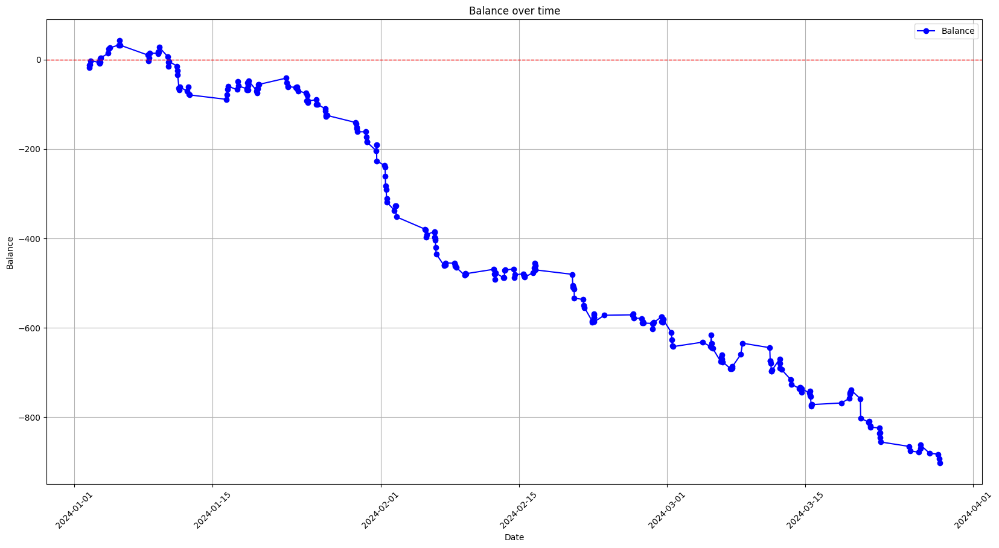

In [128]:
positions_df['ExitDate'] = pd.to_datetime(positions_df['ExitDate'])
positions_df = positions_df.sort_values(by='ExitDate')
positions_df['Balance'] = positions_df['Profit'].cumsum()

plt.figure(figsize=(20, 10))
plt.plot(positions_df['ExitDate'], positions_df['Balance'], marker='o', linestyle='-', color='b', label='Balance')
plt.xlabel('Date')
plt.ylabel('Balance')
plt.title('Balance over time')
plt.axhline(y=0, color='r', linestyle='--', linewidth=1)
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.show()

In [98]:
def calculate_trade_optuna(trading_signals, trading_params):
    trade_positions = []
    #trade_enter_buy = config['trade_enter_buy']
    #trade_enter_sell = config['trade_enter_sell']
    fixed_profit = True
    fixed_profit_value = trading_params['fixed_profit_value']
    trade_enter_buy = trading_params['trade_enter']
    trade_enter_sell = trading_params['trade_enter']
    bar_distance = 60 # in seconds  
    barNo_before_EOD = trading_params['barNo_before_EOD']
    min_bar_enter_trade_before_EOD = trading_params['min_bar_enter_trade_before_EOD']
    risk = trading_params['risk']
    EOD_Time = '16:00'
    trades = []
    balance = 0
    profit_amount = 10
    profit_count = 0
    loss_count = 0
    partial_profit_count = 0
    partial_loss_count = 0
    buy_count = 0
    sell_count = 0
    loss_amount = profit_amount * risk
    last_trade_exit = None
    min_trade_distance = 300

                    
    for index,row in trading_signals.iterrows():
        buy_power = row['BuyPower']
        sell_power = row['SellPower']
        #print(f'Buy Power : {buy_power}, Sell Power : {sell_power}')

        #predicted_class_index = np.argmax(prob_prediction, axis=1)          #predictions.append(prediction[0])
        

        if len(trades) == 0:
            if last_trade_exit == None or  (row['Date'] - last_trade_exit) > timedelta(seconds=min_trade_distance):
                eod_dt_time = row['Date'].replace(hour=int(EOD_Time.split(':')[0]), minute=int(EOD_Time.split(':')[1]))
                latest_trade_enter_time = eod_dt_time - timedelta(seconds=min_bar_enter_trade_before_EOD * bar_distance)
                
                if row['Date'] <= latest_trade_enter_time: 
                    if buy_power > sell_power and buy_power > trade_enter_buy:
                        if fixed_profit:
                            take_profit = fixed_profit_value
                        else:
                            take_profit = row['Take_Profit_Level'] 
                        trades.append({"Type": "B", 
                                    "TakeProfit": row['Close'] + take_profit,
                                    "StopLoss": row['Close'] - (take_profit * config['risk']),
                                    "Profit": take_profit,
                                    "Active": "Y",
                                    'Entry': row['Close'],
                                    'EntryDate': row['Date']
                                    })
                        buy_count += 1
                    elif sell_power > buy_power and sell_power > trade_enter_sell:
                        take_profit = row['Take_Profit_Level'] 
                        trades.append({"Type": "S", 
                                    "TakeProfit": row['Close'] - take_profit,
                                    "Profit": take_profit,
                                    "StopLoss": row['Close'] + (take_profit * config['risk']),
                                    "Active": "Y",
                                    'Entry': row['Close'],
                                    'EntryDate': row['Date']
                                    })
                        sell_count += 1
        else:
            trade = trades[0]
            eod_dt_time = row['Date'].replace(hour=int(EOD_Time.split(':')[0]), minute=int(EOD_Time.split(':')[1]))
            max_exit_time = eod_dt_time - timedelta(seconds=barNo_before_EOD * bar_distance)
            if row['Date'] >= max_exit_time:
                trade['Active'] = 'N'
                if trade['Type'] == 'B':
                    profit = (row['Close'] - trade['Entry']) * profit_amount
                else:
                    profit = (trade['Entry'] - row['Close']) * profit_amount
                
                if profit < 0:
                    partial_loss_count += 1
                    #print(f"EOD Exit , Loss, New Balance : {balance}")
                else:
                    partial_profit_count += 1
                    #print(f"EOD Exit, Profit, New Balance : {balance}")
                last_trade_exit = row['Date']
            else:
                if buy_power > sell_power and buy_power > trade_enter_buy and trade['Type'] == 'S':
                    trade['Active'] = 'N'
                    profit = (trade['Entry'] - row['Close']) * profit_amount
                    balance += profit 
                    if profit < 0:
                        partial_loss_count += 1
                        #print(f"Partial Loss, New Balance : {balance}")
                    else:
                        partial_profit_count += 1
                        #print(f"Partial Profit, New Balance : {balance}")
                    last_trade_exit = row['Date']

                elif sell_power > buy_power and sell_power > trade_enter_sell and trades[0]['Type'] == 'B':
                    trade['Active'] = 'N'
                    profit = (row['Close'] - trade['Entry']) * profit_amount
                    balance += profit
                    if profit < 0:
                        partial_loss_count += 1
                        #print(f"Partial Loss, New Balance : {balance}")
                    else:
                        partial_profit_count += 1
                        #print(f"Partial Profit, New Balance : {balance}")
                    last_trade_exit = row['Date']
        
        
        for trade in trades:
            if (trade['Type'] == 'B' and row['High'] >= trade['TakeProfit']) or (trade['Type'] == 'S' and row['Low'] <= trade['TakeProfit']):
                trade['Active'] = 'N'
                balance += (trade['Profit'] * profit_amount)
                profit_count += 1
                last_trade_exit = row['Date']
                #print(f"Take Profit, New Balance : {balance}")             
            elif (trade['Type'] == 'B' and row['Low'] <= trade['StopLoss']) or (trade['Type'] == 'S' and row['High'] >= trade['StopLoss']):
                trade['Active'] = 'N'
                balance -= (trade['Profit'] * loss_amount)
                loss_count += 1
                last_trade_exit = row['Date']
                #print(f"Stop Loss, New Balance : {balance}")


        # Filter out all trades that are not active
        trades = [trade for trade in trades if trade['Active'] == 'Y']
    return balance    
    #print(f"Final Balance : {balance} \n Take Profit count : {profit_count} \n Stop Loss count : {loss_count} \n Partial Profit count : {partial_profit_count} \n Partial Loss count : {partial_loss_count}")
    #print(f"Buy count : {buy_count} \n Sell count : {sell_count}")

In [116]:
def trading_objective(trial):
    params = {
        'trade_enter': trial.suggest_float('trade_enter', 0.3, 2.0),
        'fixed_profit_value': trial.suggest_float('fixed_profit_value', 0.4, 4.0),
        'barNo_before_EOD': trial.suggest_int('barNo_before_EOD', 1, 30),
        'min_bar_enter_trade_before_EOD': trial.suggest_int('min_bar_enter_trade_before_EOD', 5, 30),
        'risk': trial.suggest_float('risk', 0.1, 2.0)
    }

    balance = calculate_trade_optuna(tr_signals, params)

    return balance

In [117]:
trading_study = optuna.create_study(direction='maximize') # for metric auc its maximuze, and for mlogloss its minimie
trading_study.optimize(trading_objective, n_trials=200)

[I 2025-03-05 16:16:01,617] A new study created in memory with name: no-name-81993938-1611-4e59-9014-ec2f8d6f0e96
[I 2025-03-05 16:16:02,281] Trial 0 finished with value: -189.57382455835045 and parameters: {'trade_enter': 0.8552395087298419, 'fixed_profit_value': 1.4312603588442006, 'barNo_before_EOD': 23, 'min_bar_enter_trade_before_EOD': 19, 'risk': 1.03938331749996}. Best is trial 0 with value: -189.57382455835045.
[I 2025-03-05 16:16:02,817] Trial 1 finished with value: -126.10400193642336 and parameters: {'trade_enter': 1.310061189953398, 'fixed_profit_value': 1.4595587602516473, 'barNo_before_EOD': 7, 'min_bar_enter_trade_before_EOD': 9, 'risk': 1.4506755048723845}. Best is trial 1 with value: -126.10400193642336.
[I 2025-03-05 16:16:03,332] Trial 2 finished with value: -134.6799271656511 and parameters: {'trade_enter': 1.4198620664734223, 'fixed_profit_value': 0.6566135506819897, 'barNo_before_EOD': 9, 'min_bar_enter_trade_before_EOD': 6, 'risk': 1.8619638321200547}. Best is tr

In [119]:
print(trading_study.best_params)
trading_params_tuned = trading_study.best_params

{'trade_enter': 1.8379569277805503, 'fixed_profit_value': 2.5065575765591293, 'barNo_before_EOD': 25, 'min_bar_enter_trade_before_EOD': 17, 'risk': 1.8818377732556189}


In [118]:
trading_study.best_value

0.0

In [70]:
def calculate_trade_optuna_2values(trading_signals, trading_params):
    trade_positions = []
    #trade_enter_buy = config['trade_enter_buy']
    #trade_enter_sell = config['trade_enter_sell']
    fixed_profit = True
    fixed_profit_value = trading_params['fixed_profit_value']
    trade_enter_buy = trading_params['trade_enter']
    trade_enter_sell = trading_params['trade_enter']
    bar_distance = 60 # in seconds  
    barNo_before_EOD = trading_params['barNo_before_EOD']
    min_bar_enter_trade_before_EOD = trading_params['min_bar_enter_trade_before_EOD']
    risk = trading_params['risk']
    EOD_Time = '16:00'
    trades = []
    balance = 0
    profit_amount = 10
    profit_count = 0
    loss_count = 0
    partial_profit_count = 0
    partial_loss_count = 0
    buy_count = 0
    sell_count = 0
    loss_amount = profit_amount * risk
    total_trade_length = 0
                    
    for index,row in trading_signals.iterrows():
        buy_power = row['BuyPower']
        sell_power = row['SellPower']
        #print(f'Buy Power : {buy_power}, Sell Power : {sell_power}')

        #predicted_class_index = np.argmax(prob_prediction, axis=1)          #predictions.append(prediction[0])
        

        if len(trades) == 0:
            eod_dt_time = row['Date'].replace(hour=int(EOD_Time.split(':')[0]), minute=int(EOD_Time.split(':')[1]))
            latest_trade_enter_time = eod_dt_time - timedelta(seconds=min_bar_enter_trade_before_EOD * bar_distance)
            if row['Date'] <= latest_trade_enter_time: 
                if buy_power > sell_power and buy_power > trade_enter_buy:
                    if fixed_profit:
                        take_profit = fixed_profit_value
                    else:
                        take_profit = row['Take_Profit_Level'] 
                    trades.append({"Type": "B", 
                                "TakeProfit": row['Close'] + take_profit,
                                "StopLoss": row['Close'] - (take_profit * config['risk']),
                                "Profit": take_profit,
                                "Active": "Y",
                                'Entry': row['Close'],
                                'EntryDate': row['Date']
                                })
            
                    buy_count += 1
                elif sell_power > buy_power and sell_power > trade_enter_sell:
                    take_profit = row['Take_Profit_Level'] 
                    trades.append({"Type": "S", 
                                "TakeProfit": row['Close'] - take_profit,
                                "Profit": take_profit,
                                "StopLoss": row['Close'] + (take_profit * config['risk']),
                                "Active": "Y",
                                'Entry': row['Close'],
                                'EntryDate': row['Date']
                                })
                    sell_count += 1
        else:
            trade = trades[0]
            eod_dt_time = row['Date'].replace(hour=int(EOD_Time.split(':')[0]), minute=int(EOD_Time.split(':')[1]))
            max_exit_time = eod_dt_time - timedelta(seconds=barNo_before_EOD * bar_distance)
            if row['Date'] >= max_exit_time:
                trade['Active'] = 'N'
                if trade['Type'] == 'B':
                    profit = (row['Close'] - trade['Entry']) * profit_amount
                else:
                    profit = (trade['Entry'] - row['Close']) * profit_amount
                
                if profit < 0:
                    partial_loss_count += 1
                    #print(f"EOD Exit , Loss, New Balance : {balance}")
                else:
                    partial_profit_count += 1
                    #print(f"EOD Exit, Profit, New Balance : {balance}")
                trade_time = (pd.to_datetime(row['Date']) -  pd.to_datetime(trade['EntryDate'])) // pd.Timedelta(minutes=5)
                total_trade_length += trade_time
            else:
                if buy_power > sell_power and buy_power > trade_enter_buy and trade['Type'] == 'S':
                    trade['Active'] = 'N'
                    profit = (trade['Entry'] - row['Close']) * profit_amount
                    balance += profit 
                    if profit < 0:
                        partial_loss_count += 1
                        #print(f"Partial Loss, New Balance : {balance}")
                    else:
                        partial_profit_count += 1
                        #print(f"Partial Profit, New Balance : {balance}")

                    trade_time = (pd.to_datetime(row['Date']) -  pd.to_datetime(trade['EntryDate'])) // pd.Timedelta(minutes=5)
                    total_trade_length += trade_time

                elif sell_power > buy_power and sell_power > trade_enter_sell and trades[0]['Type'] == 'B':
                    trade['Active'] = 'N'
                    profit = (row['Close'] - trade['Entry']) * profit_amount
                    balance += profit
                    if profit < 0:
                        partial_loss_count += 1
                        #print(f"Partial Loss, New Balance : {balance}")
                    else:
                        partial_profit_count += 1
                        #print(f"Partial Profit, New Balance : {balance}")
                    trade_time = (pd.to_datetime(row['Date']) -  pd.to_datetime(trade['EntryDate'])) // pd.Timedelta(minutes=5)
                    total_trade_length += trade_time
        
        for trade in trades:
            if (trade['Type'] == 'B' and row['High'] >= trade['TakeProfit']) or (trade['Type'] == 'S' and row['Low'] <= trade['TakeProfit']):
                trade['Active'] = 'N'
                balance += (trade['Profit'] * profit_amount)
                profit_count += 1
                #print(f"Take Profit, New Balance : {balance}")  
                trade_time = (pd.to_datetime(row['Date']) -  pd.to_datetime(trade['EntryDate'])) // pd.Timedelta(minutes=5)
                total_trade_length += trade_time           
            elif (trade['Type'] == 'B' and row['Low'] <= trade['StopLoss']) or (trade['Type'] == 'S' and row['High'] >= trade['StopLoss']):
                trade['Active'] = 'N'
                balance -= (trade['Profit'] * loss_amount)
                loss_count += 1
                #print(f"Stop Loss, New Balance : {balance}")
                trade_time = (pd.to_datetime(row['Date']) -  pd.to_datetime(trade['EntryDate'])) // pd.Timedelta(minutes=5)
                total_trade_length += trade_time


        # Filter out all trades that are not active
        trades = [trade for trade in trades if trade['Active'] == 'Y']
    total_trade_count = buy_count + sell_count
    total_loss_count = loss_count + partial_loss_count
    return balance, total_trade_length / total_trade_count   
    #print(f"Final Balance : {balance} \n Take Profit count : {profit_count} \n Stop Loss count : {loss_count} \n Partial Profit count : {partial_profit_count} \n Partial Loss count : {partial_loss_count}")
    #print(f"Buy count : {buy_count} \n Sell count : {sell_count}")

In [73]:
def trading_objective_2(trial):
    params = {
        'trade_enter': trial.suggest_float('trade_enter', 0.2, 2.0),
        'fixed_profit_value': trial.suggest_float('fixed_profit_value', 0.4, 4.0),
        'barNo_before_EOD': trial.suggest_int('barNo_before_EOD', 1, 30),
        'min_bar_enter_trade_before_EOD': trial.suggest_int('min_bar_enter_trade_before_EOD', 5, 30),
        'risk': trial.suggest_float('risk', 0.1, 2.0)
    }

    balance, trade_length = calculate_trade_optuna_2values(tr_signals, params)

    return balance, trade_length

In [74]:
trading_study_2 = optuna.create_study(directions=['maximize', 'minimize']) # for metric auc its maximuze, and for mlogloss its minimie
trading_study_2.optimize(trading_objective_2, n_trials=200)

[I 2025-03-05 14:59:22,903] A new study created in memory with name: no-name-564c1303-d542-4fb9-9ea9-89d3a91dbce6
[I 2025-03-05 14:59:23,417] Trial 0 finished with values: [-398.6217133022649, 11.57857142857143] and parameters: {'trade_enter': 0.5009757874887094, 'fixed_profit_value': 2.508780983135823, 'barNo_before_EOD': 18, 'min_bar_enter_trade_before_EOD': 22, 'risk': 0.9980491836385932}.
[I 2025-03-05 14:59:23,908] Trial 1 finished with values: [-177.53152980149864, 8.119205298013245] and parameters: {'trade_enter': 0.5097916002952668, 'fixed_profit_value': 1.1483498634951403, 'barNo_before_EOD': 13, 'min_bar_enter_trade_before_EOD': 25, 'risk': 0.6786257450834839}.
[I 2025-03-05 14:59:24,420] Trial 2 finished with values: [-1686.7506082165273, 6.884146341463414] and parameters: {'trade_enter': 0.3519562960135584, 'fixed_profit_value': 1.7400696189856424, 'barNo_before_EOD': 4, 'min_bar_enter_trade_before_EOD': 27, 'risk': 1.5654435364427866}.
[I 2025-03-05 14:59:24,916] Trial 3 f

In [75]:
sorted_trials = sorted(trading_study_2.best_trials, key=lambda t: t.values[0], reverse=True)
for trial in sorted_trials:
    print(f"Trial number : {trial.number}, Balance : {trial.values[0]}, Trade Length : {trial.values[1]}")

Trial number : 55, Balance : 831.2336781920219, Trade Length : 2.416065911431514
Trial number : 153, Balance : 831.2336781920219, Trade Length : 2.416065911431514
Trial number : 171, Balance : -680.7393217869685, Trade Length : 2.27705112960761
Trial number : 101, Balance : -1081.700902017323, Trade Length : 1.937888198757764


In [76]:
sorted_trials[0].params

{'trade_enter': 0.2415991569198071,
 'fixed_profit_value': 0.7241734557069652,
 'barNo_before_EOD': 7,
 'min_bar_enter_trade_before_EOD': 6,
 'risk': 0.11947859821788873}

In [ ]:
for trial in trading_study_2.trials:
    print(f"Trial {trial.number}: Best value = {trial.values}")

Trial 0: Best value = [420.80199689188004, 263.0]
Trial 1: Best value = [-49.93553682101156, 3.0]
Trial 2: Best value = [-3.7528638737576046, 290.0]
Trial 3: Best value = [132.07973992854397, 85.0]
Trial 4: Best value = [5.487857695356613, 133.0]
Trial 5: Best value = [92.4904572949738, 24.0]
Trial 6: Best value = [-9.453323356199078, 9.0]
Trial 7: Best value = [-233.67029260752417, 232.0]
Trial 8: Best value = [87.99203310314907, 97.0]
Trial 9: Best value = [-247.3006446033359, 189.0]
Trial 10: Best value = [99.58457331213921, 151.0]
Trial 11: Best value = [869.1926460884704, 599.0]
Trial 12: Best value = [164.44383489905508, 203.0]
Trial 13: Best value = [267.63740176036555, 183.0]
Trial 14: Best value = [-180.32554504400116, 158.0]
Trial 15: Best value = [35.414034673272425, 112.0]
Trial 16: Best value = [-599.0375067879481, 556.0]
Trial 17: Best value = [-30.23947556616759, 67.0]
Trial 18: Best value = [-322.7453503622835, 424.0]
Trial 19: Best value = [-39.54070262477896, 6.0]
Tri

In [108]:
def compute_trade_signal(row):
    trade_enter_buy = 0.5
    trade_enter_sell = 0.5
    if row['BuyPower'] > trade_enter_buy and row['BuyPower'] > row['SellPower']:
        return 'B'
    elif row['SellPower'] > trade_enter_sell and row['SellPower'] > row['BuyPower']:
        return 'S'
    else:
        return 'N'
    
tr_signals['SignalNew'] = tr_signals.apply(compute_trade_signal, axis=1)

In [99]:
buy_signals = tr_signals[tr_signals['Signal'] == 'B']
sell_signals = tr_signals[tr_signals['Signal']== 'S']
trade_to_show = '2024-01-05'
#trading_data['Date'] = pd.to_datetime(trading_data['Date'])
fig = make_subplots(rows=2, cols=1, shared_xaxes=True, 
                    row_heights=[0.7, 0.3], vertical_spacing=0.1,
                    subplot_titles=("CandleStick Chart", "Buy/Sell Signals"))
fig.add_trace(
    go.Candlestick(
        x=tr_signals['Date'], 
        open=tr_signals['Open'], 
        high=tr_signals['High'], 
        low=tr_signals['Low'], 
        close=tr_signals['Close'],
        name='OHLC'
        ), row=1, col=1
)
'''
fig.add_trace(
    go.Scatter(
        x=buy_signals['Date'], 
        y=buy_signals['Low'], 
        mode='markers', 
        name='Buy Signal', 
        marker=dict(color='blue', size=10)))

fig.add_trace(
    go.Scatter(
        x=sell_signals['Date'], 
        y=sell_signals['High'], 
        mode='markers', 
        name='Sell Signal', 
        marker=dict(color='yellow', size=10)))
'''
for index, row in positions_df.iterrows():
    if row['Type'] == 'B':
        entry_symbol = 'triangle-up'
        entry_color = 'blue'
        exit_symbol = 'triangle-down'
        exit_color ='green' if row['Profit'] >= 0 else 'red'
    elif row['Type'] == 'S':
        entry_symbol = 'triangle-down'
        entry_color = 'yellow'
        exit_symbol = 'triangle-up'
        exit_color = 'green' if row['Profit'] >= 0 else 'red'
    
    fig.add_trace(
        go.Scatter(
            x=[row['EntryDate']],
            y=[row['Entry'] + 0.1],
            mode='markers',
            marker=dict(symbol=entry_symbol, size=10, color=entry_color),
            name=f'Entry {row['Type']}'
        ))
    
    fig.add_trace(
        go.Scatter(
            x=[row['ExitDate']],
            y=[row['Exit'] - 0.1],
            mode='markers',
            marker=dict(symbol=exit_symbol, size=10, color=exit_color),
            name=f'Exit {row["Type"]}'
        ))
  
fig.add_trace(
    go.Scatter(
        x=tr_signals['Date'],
        y=tr_signals['BuyPower'],
        mode='lines',
        name='Buy Signal',
        line=dict(color='green', width=2)
    ), row=2, col=1
)

fig.add_trace(
    go.Scatter(
        x=tr_signals['Date'],
        y=tr_signals['SellPower'],
        mode='lines',
        name='Sell Signal',
        line=dict(color='red', width=2)
    ), row=2, col=1
)
  

fig.update_layout(
    title='CandleStick chart with Buy Sell Signals',
    xaxis=dict(type="date", 
               rangebreaks=[
                   dict(bounds=["sat", "mon"]),
                   dict(bounds=[16,9.5], pattern='hour')
               ]              
            ),
    xaxis_rangeslider_visible=False,
    height=600,
    hovermode='x unified'
)



fig.update_xaxes(matches='x')

fig.show()